# <center> R1.13 introduction à Python <br> TP4 - Nim, Marienbad et IA </center>
<center> 2024/2025 - Thibault Godin </center>
<center> IUT de Vannes, BUT Informatique </center>

***

Dans ce TP, on va voir une méthode d'intelligence artificielle classique, **l'apprentissage par renforcement**


On va présenter cette notion à l'aide d'une activité proposée par des collègues de la (Maison des Mathématiques et de l'Informatique)[https://mmi-lyon.fr/] (MMI) et du réseau Informatique Débranchée sur le jeu de _Nim_, puis on essaiera de l'appliquer au jeu de Grundy vu en JAVA en R1.01



- https://mmi-lyon.fr/?site_ressource_peda=jeu-de-nim-et-ia-avec-python
- https://mmi-lyon.fr/?site_ressource_peda=jeu-de-nim-et-ia
- video 

In [2]:
import random
import time

import numpy as np


import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 12)

from IPython.display import HTML

# Jeu de Nim


## Mise en place


Le jeu de Nim se joue à 2 joueurs selon les règles suivantes : 
- On commence la partie avec un tas de $n$ allumettes
- Les deux joueurs jouent alternativement
- Seulement 1, 2, ou 3 allumette(s) peuvent être retirée(s) par un joueur à chaque tour
- La personne qui tire la dernière alumettre a gagné (version normale, on peut aussi dire "la personne qui ne peut plus jouer a perdu")

>**_question 1_** <br>
jouer (en silence) une ou deux parties avec un voisin

In [10]:
np.random.rand()< .5

True

>**_question 2_**<br> 
lire (en diagonale) à quoi ressemblent les (stratégies gagnantes)[https://interstices.info/jeux-de-nim/] de ce jeu 

>**_question 3_**<br> 
visualiser et comprendre l'apprentissage par renforcement proposé pour le jeu de Nim sur https://projet.liris.cnrs.fr/~mam/machine/




--------------------------



## Niammi : Nim Artificial Intelligence Maison des Mathématiques et de l'Informatique

Voici un programme Python (implémenté par Olivier Druet de la MMI) permettant de jouer au jeu de Nim contre un ordinateur _qui apprend au fur et à mieux jouer_. 

>**_question 4_**<br> 
lire et comprendre

In [21]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Fri Jan 21 10:32:50 2022

@author: druet
"""

import random
import time


################### le message de bienvenue et d'explication ##################

def welcome_message():
    print("""
----------------------------------------------------------------------------
                        Règles du jeu de Nim
----------------------------------------------------------------------------
Règles : 1 - L'utilisateur et l'ordinateur jouent à tour de rôle.
         2 - L'ordinateur commence.
         3 - Seulement 1 ou 2 bâtons peuvent être retirés à chaque coup.
         4 - Celui qui tire le dernier bâton a gagné.
         
----------------------------------------------------------------------------
                           Apprentissage
----------------------------------------------------------------------------                        
Suivant qu'il gagne ou perd, l'ordinateur reçoit une récompense ou une punition.
----------------------------------------------------------------------------
""")

#### Nous faisons commencer l'ordinateur parce que le premier joueur a une 
#### stratégie gagnante. Si le joueur commence et qu'il joue bien, la machine 
#### perdra quoiqu'elle fasse et n'apprendra rien. 

###############################################################################


################## définition et impression de la position de jeu #############

def printboard(n):
    board=[]
    for _ in range(n):
        board.append("/")
    print("\n----------------------------------------------------------------------------")
    print("      ",*board, sep="   ")
    print("----------------------------------------------------------------------------\n")
    print("Il reste " + str(n) + " allumettes.")
    
###############################################################################


################### initialisation de la machine ##############################

nombre_allumettes=8 ### vous pouvez changer le nombre d'allumettes de départ
board = [] ### le plateau de jeu
boulesjaunes = [] ### correspond au nombre de boules jaunes dans la case
boulesrouges = [] ### correspond au nombre de boules rouges dans la case
tirage = [] ### correspondra au tirage dans une partie
for _ in range(nombre_allumettes):
    boulesjaunes.append(2)
    boulesrouges.append(2)
    tirage.append(0)
#### Attention Python commence à 0 #####
boulesrouges[0]=0 #### il ne faut pas mettre de boules rouges dans la case 0, coup interdit


###############################################################################


#################### programme principal : jeu + renforcement #################
welcome_message()
uneautrepartie=True
compteur_partie=0
time.sleep(1)
print("La probabilité de gain de l'ordinateur à la première partie si le joueur joue optimalement est de 12,5 %")
time.sleep(1)
while uneautrepartie :
    player = "CMP"
    allumettes=nombre_allumettes
    tirage=[0,0,0,0,0,0,0,0]
    while allumettes>0:
        printboard(allumettes)  ### imprime la position de jeu
        time.sleep(1)
        if player=='CMP': ### c'est à l'ordinateur de jouer
            print("\nL'ordinateur choisit de retirer...")
            time.sleep(1)
            somme=boulesjaunes[allumettes-1]+boulesrouges[allumettes-1]
            boulehasard=random.randint(1,somme)##permet de tirer jaune ou rouge
            if boulehasard <= boulesjaunes[allumettes-1]: ##la machine a tiré jaune, i.e. elle enlève une allumette
                tirage[allumettes-1]=1
                allumettes=allumettes-1
                print("1 allumette.")
            else:
                tirage[allumettes-1]=2
                allumettes=allumettes-2
                print("2 allumettes.")
            if allumettes==0:
                winner='CMP'
            else:
                player='USER'  
        else: ### c'est au joueur de jouer
#### on demande au joueur ce qu'il souhaite jouer avec vérification que c'est un coup légal
            coup_joueur=0
            print("\n--À vous de jouer !--")
            while coup_joueur not in range(1, 3) or coup_joueur>allumettes:
                try:
                    coup_joueur = int(input("\nQuel est votre choix ?"))
                    if coup_joueur == 0:
                        print("\nVous devez enlever au moins une allumette !")
                    elif coup_joueur not in range(1, 3) or coup_joueur>allumettes:
                        print("\nVous ne pouvez pas enlever autant d'allumettes !")
                        coup_joueur = int(input("\nQuel est votre choix ?"))
                except Exception as e:
                    print("\nCela ne semble pas une réponse valide.\nError: " + str(e) + "\nRecommencez !")
##### fin du choix du joueur
            allumettes=allumettes-coup_joueur
            if allumettes==0:
                winner='USER'
            else:
                player='CMP' 
    compteur_partie+=1
##### fin de la partie ######
##### annonce des résultats #####
    if winner=='CMP':
        print("\n----------------------------------------------------------------------------")
        print("L'ordinateur a gagné, nous allons le récompenser.")
        print("----------------------------------------------------------------------------\n")
    else:
        print("\n----------------------------------------------------------------------------")
        print("Bravo ! Vous avez gagné ! Nous allons punir l'ordinateur.")
        print("----------------------------------------------------------------------------\n")
##### Apprentissage : récompense ou punition de l'ordinateur#####        
    if winner=='CMP': ###récompense
        for i in range(nombre_allumettes):
            if tirage[i]==1:
                boulesjaunes[i]=boulesjaunes[i]+1
            if tirage[i]==2:
                boulesrouges[i]=boulesrouges[i]+1
    else: ###punition
        for i in range(nombre_allumettes):
            if tirage[i]==1:
                boulesjaunes[i]=boulesjaunes[i]-1
            if tirage[i]==2:
                boulesrouges[i]=boulesrouges[i]-1
####### fin de la récompense ou de la punition #################
####### réinitialisation des verres vides ######################
    for i in range(nombre_allumettes):
        if (boulesjaunes[i]==0) and (boulesrouges[i]==0):
            boulesjaunes[i]=2
            boulesrouges[i]=2
######## impression de l'état des verres #######################
    time.sleep(1)
    for i in range(nombre_allumettes):
        print("Dans le verre " + str(i+1) +", il y a " + str(boulesjaunes[i]) + " boules jaunes et " + str(boulesrouges[i]) + " boules rouges.")
################################################################
############ calcul de la probabilité de gagner ################
    time.sleep(1)
    if (boulesjaunes[3]/(boulesjaunes[3]+boulesrouges[3]))>(boulesrouges[4]/(boulesjaunes[4]+boulesrouges[4])):
        proba=(boulesrouges[7]/(boulesjaunes[7]+boulesrouges[7]))*(boulesrouges[4]/(boulesjaunes[4]+boulesrouges[4]))*(boulesrouges[1]/(boulesjaunes[1]+boulesrouges[1]))
    else:
        proba=(boulesrouges[7]/(boulesjaunes[7]+boulesrouges[7]))*(boulesjaunes[3]/(boulesjaunes[3]+boulesrouges[3]))*(boulesrouges[1]/(boulesjaunes[1]+boulesrouges[1]))
    print("\n----------------------------------------------------------------------------")
    print("Vous avez joué "+ str(compteur_partie) +" parties.")
    print("----------------------------------------------------------------------------\n")
    print("\n----------------------------------------------------------------------------")
    print("La probabilité de gain de l'ordinateur à la prochaine partie si le joueur joue optimalement (en connaissant l'état des verres :-)) est de " + str(round(proba*100,2)) + "%")
    print("----------------------------------------------------------------------------\n")
################################################################
############ On continue ? ################    
    test=True
    while test:
        another_go = input("\nVoulez-vous rejouer ?[O/N]: ")
        if another_go in ("o","O"):
            uneautrepartie=True
            test=False
        elif another_go in ("n","N"):
            uneautrepartie=False
            test=False
        else:
            print("\nChoix invalide. Recommencez !")    
############################################            
            




 



----------------------------------------------------------------------------
                        Règles du jeu de Nim
----------------------------------------------------------------------------
Règles : 1 - L'utilisateur et l'ordinateur jouent à tour de rôle.
         2 - L'ordinateur commence.
         3 - Seulement 1 ou 2 bâtons peuvent être retirés à chaque coup.
         4 - Celui qui tire le dernier bâton a gagné.
         
----------------------------------------------------------------------------
                           Apprentissage
----------------------------------------------------------------------------                        
Suivant qu'il gagne ou perd, l'ordinateur reçoit une récompense ou une punition.
----------------------------------------------------------------------------

La probabilité de gain de l'ordinateur à la première partie si le joueur joue optimalement est de 12,5 %

----------------------------------------------------------------------------



Voulez-vous rejouer ?[O/N]: o

----------------------------------------------------------------------------
         /   /   /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 8 allumettes.

L'ordinateur choisit de retirer...
1 allumette.

----------------------------------------------------------------------------
         /   /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 7 allumettes.

--À vous de jouer !--

Quel est votre choix ?1

----------------------------------------------------------------------------
         /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 6 allumettes.

L'ordinateur choisit de retirer...
1 allumette.

----------------------------------------------------------------------------
         /   /   /   /   /
----------------------------------------------------------------------------


Voulez-vous rejouer ?[O/N]: o

----------------------------------------------------------------------------
         /   /   /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 8 allumettes.

L'ordinateur choisit de retirer...
1 allumette.

----------------------------------------------------------------------------
         /   /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 7 allumettes.

--À vous de jouer !--

Quel est votre choix ?1

----------------------------------------------------------------------------
         /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 6 allumettes.

L'ordinateur choisit de retirer...
2 allumettes.

----------------------------------------------------------------------------
         /   /   /   /
----------------------------------------------------------------------------

I

2 allumettes.

----------------------------------------------------------------------------
         /   /   /   /   /   /
----------------------------------------------------------------------------

Il reste 6 allumettes.

--À vous de jouer !--

Quel est votre choix ?1

----------------------------------------------------------------------------
         /   /   /   /   /
----------------------------------------------------------------------------

Il reste 5 allumettes.

L'ordinateur choisit de retirer...
2 allumettes.

----------------------------------------------------------------------------
         /   /   /
----------------------------------------------------------------------------

Il reste 3 allumettes.

--À vous de jouer !--

Quel est votre choix ?2

----------------------------------------------------------------------------
         /
----------------------------------------------------------------------------

Il reste 1 allumettes.

L'ordinateur choisit de retirer...


Dans le verre 1, il y a 3 boules jaunes et 0 boules rouges.
Dans le verre 2, il y a 0 boules jaunes et 5 boules rouges.
Dans le verre 3, il y a 1 boules jaunes et 2 boules rouges.
Dans le verre 4, il y a 2 boules jaunes et 0 boules rouges.
Dans le verre 5, il y a 0 boules jaunes et 4 boules rouges.
Dans le verre 6, il y a 1 boules jaunes et 0 boules rouges.
Dans le verre 7, il y a 2 boules jaunes et 2 boules rouges.
Dans le verre 8, il y a 0 boules jaunes et 3 boules rouges.

----------------------------------------------------------------------------
Vous avez joué 13 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
La probabilité de gain de l'ordinateur à la prochaine partie si le joueur joue optimalement (en connaissant l'état des verres :-)) est de 100.0%
----------------------------------------------------------------------------


Voulez-vous rejouer ?[O/N]: o

----

# Marienbad


plan conseillé : 

1. affichage du plateau
2. alternance des joueurs et propositions des coups admissibles
3. condition de victoire
4. stockage de stratégie
5. jeu humain v. humain
6. jeu humain v. ordinateur
8. règle de l'apprentissage de l'ordinateur (en cas de victoire ou de défaite
9. entrainement de l'ordinateur contre l'humain
10. entrainement de l'ordinateur contre le hasard
11. entrainement de l'ordinateur contre l'ordinateur


Vous pouvez bien sûr recycler du code Java de R1.01, ainsi que le code de Nim proposé plus haut (essayez d'être aussi clair dans votre code).

Le jeu de Marienbad étant plus complexe que celui de Nim, on fera des fonctions !

**bonus** Une fois la machine entrainée, retrouver les positions gagnante à l'aide de la stratégie obtenue

In [32]:
import random
import time

################### Message de bienvenue et d'explication ##################

def message_bienvenue():
    print("""
----------------------------------------------------------------------------
                        Règles du jeu de Marienbad
----------------------------------------------------------------------------
Règles : 1 - Deux joueurs s'affrontent à tour de rôle.
         2 - L'ordinateur commence.
         3 - Le joueur peut retirer un ou plusieurs bâtons, mais seulement dans une seule rangée.
         4 - Celui qui prend la dernière allumette gagne la partie.
----------------------------------------------------------------------------
                           Modes de jeu
----------------------------------------------------------------------------                        
1 - Humain contre Ordinateur
2 - Ordinateur contre Hasard
3 - Ordinateur contre Ordinateur
4 - Humain contre Humain
----------------------------------------------------------------------------
                           Apprentissage
----------------------------------------------------------------------------
Suivant qu'il gagne ou perd, l'ordinateur reçoit une récompense ou une punition.
----------------------------------------------------------------------------
""")

################### Affichage du plateau ##################

def affiche(plateau):
    print("\nPlateau actuel :")
    for i, rangee in enumerate(plateau):
        print(f"Rangée {i + 1}: {'| ' * rangee} ({rangee})")
    print()

################### Initialisation du jeu de Marienbad ##################

### Initialisation du plateau ###
def configurer_plateau():
    while True:
        try:
            nb_rangees = int(input("Entrez le nombre de rangées (entre 2 et 6) : "))
            if nb_rangees <= 1 or nb_rangees >= 7:
                print("Le nombre de rangées doit être compris entre 2 et 6.")
            else:
                return [i * 2 - 1 for i in range(1, nb_rangees + 1)]
        except ValueError:
            print("Entrée invalide. Veuillez entrer un entier positif.")

### Fait un coup aléatoire ###
def coup_aleatoire(plateau_actuel):
    rangees_valides = [i for i, rangee in enumerate(plateau_actuel) if rangee > 0]
    rangee = random.choice(rangees_valides)
    allumettes = random.randint(1, plateau_actuel[rangee])
    return rangee, allumettes

### Crée un dictionnaire pour tous les coups possibles pour chaque état possible du plateau ###
def possibilites(plateau):
    copie_plateau = [0 for _ in range(len(plateau))]
    dico_possibilites = {}
    
    while copie_plateau != plateau:
        copie_plateau[-1] += 1
        
        for i in range(len(copie_plateau) - 1, 0, -1):
            if copie_plateau[i] == plateau[i] + 1:
                copie_plateau[i] = 0
                copie_plateau[i - 1] += 1
        
            dico_possibilites[str(copie_plateau)] = {}
            for i in range(len(copie_plateau)):
                for j in range(copie_plateau[i]):
                    dico_possibilites[str(copie_plateau)][i, j + 1] = 15
    
    return dico_possibilites

### Le coup de l'ordinateur ###
def coup_ordi(plateau_actuel, historique, dico_possibilites):
    leCoup = random.choices(list(dico_possibilites[str(plateau_actuel)].keys()), weights = dico_possibilites[str(plateau_actuel)].values())
    historique.append([str(plateau_actuel), leCoup[0]])

    return leCoup[0][0], leCoup[0][1]

""" ### Calcule la probabilité de gagner ###
def calcul_probabilites():
    probabulite_totale = 0
    return probabulite_totale """



################### Programme principal ##################

message_bienvenue()
mode = 0

# Boucle pour le choix du mode de jeux
while mode not in [1, 2, 3, 4]:
    try:
        mode = int(input("\nChoisissez un mode de jeu (1, 2, 3 ou 4) : "))
        if mode not in [1, 2, 3, 4]:
            print("Mode invalide. Veuillez choisir entre 1, 2, 3 ou 4.")
    except ValueError:
        print("Entrée invalide. Veuillez saisir un nombre.")

plateau = configurer_plateau()

if mode == 2 or mode == 3:
    nb_parties_a_jouer = int(input("\nChoisissez le nombre de parties à jouer : "))

memoire_cmp = possibilites(plateau)
if mode == 3:
    memoire_cmp2 = possibilites(plateau)

if mode == 4:
    nom_joueur1 = input("Entrez le nom du premier joueur : ")
    nom_joueur2 = input("Entrez le nom du deuxième joueur : ")


uneautrepartie = True
compteur_parties = 0 
score = [0, 0]

# Boucle principale pour le déroulé d'une partie 
while uneautrepartie:
    if mode == 1:
        joueur = 'Ordinateur'
    elif mode == 2:
        joueur = random.choice(['Ordinateur', 'Aleatoire'])
    elif mode == 3:
        joueur = random.choice(['Ordinateur', 'Ordinateur 2'])
    elif mode == 4:
        joueur = random.choice([nom_joueur1, nom_joueur2])

    plateau_actuel = plateau[:]

    historique_cmp = []
    if mode == 3:
        historique_cmp2 = []

    # Boucle pour le déroulé de la partie (tant qu'il reste des allumettes)
    while sum(plateau_actuel) > 0:
        affiche(plateau_actuel)

        if joueur == 'Ordinateur':  # Tour de l'ordinateur
            print("\nL'ordinateur choisit de jouer...")
            rangee, allumettes = coup_ordi(plateau_actuel, historique_cmp, memoire_cmp)
            plateau_actuel[rangee] -= allumettes
            print(f"L'ordinateur enlève {allumettes} allumette(s) de la rangée {allumettes + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = 'Ordinateur'
            else:
                joueur = 'Utilisateur' if mode == 1 else 'Aleatoire' if mode == 2 else 'Ordinateur 2'

        elif joueur == 'Utilisateur':  # Tour de l'utilisateur
            print("\n-- À vous de jouer ! --")
            coup_valide = False

            while not coup_valide:
                try:
                    rangee = int(input("Choisissez une rangée : ")) - 1
                    allumettes = int(input("Combien d'allumettes voulez-vous enlever ? "))

                    if rangee < 0 or rangee >= len(plateau_actuel) or plateau_actuel[rangee] < allumettes or allumettes <= 0:
                        print("Coup invalide. Recommencez.")
                    else:
                        coup_valide = True
                except ValueError:
                    print("Entrée invalide. Recommencez.")

            plateau_actuel[rangee] -= allumettes
            print(f"Vous avez retiré {allumettes} allumette(s) de la rangée {rangee + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = 'Utilisateur'
            else:
                joueur = 'Ordinateur'

        elif joueur == 'Aleatoire':  # Tour d'un joueur aléatoire
            print("\nLe joueur au hasard choisit de jouer...")
            rangee, allumettes = coup_aleatoire(plateau_actuel)
            plateau_actuel[rangee] -= allumettes
            print(f"Le joueur au hasard enlève {allumettes} allumette(s) de la rangée {rangee + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = 'Aleatoire'
            else:
                joueur = 'Ordinateur'

        elif joueur == 'Ordinateur 2':  # Deuxième IA dans le mode ordinateur contre ordinateur
            print("\nL'autre ordinateur choisit de jouer...")
            rangee, allumettes = coup_ordi(plateau_actuel, historique_cmp2, memoire_cmp2)
            plateau_actuel[rangee] -= allumettes
            print(f"L'autre ordinateur enlève {allumettes} allumette(s) de la rangée {rangee + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = 'Ordinateur 2'
            else:
                joueur = 'Ordinateur'

        elif joueur == nom_joueur1:  # Tour du premier joueur humain dans le mode JvJ
            print(f"\n-- {nom_joueur1}, à vous de jouer ! --")
            coup_valide = False

            while not coup_valide:
                try:
                    rangee = int(input("Choisissez une rangée : ")) - 1
                    allumettes = int(input("Combien d'allumettes voulez-vous enlever ? "))

                    if allumettes < 0 or allumettes >= len(plateau_actuel) or plateau_actuel[allumettes] < allumettes or allumettes <= 0:
                        print("Coup invalide. Recommencez.")
                    else:
                        coup_valide = True
                except ValueError:
                    print("Entrée invalide. Recommencez.")

            plateau_actuel[rangee] -= allumettes
            print(f"{nom_joueur1} a retiré {allumettes} allumette(s) de la rangée {rangee + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = nom_joueur1
            else:
                joueur = nom_joueur2

        elif joueur == nom_joueur2:  # Tour du deuxième joueur humain dans le mode JvJ
            print(f"\n-- {nom_joueur2}, à vous de jouer ! --")
            coup_valide = False

            while not coup_valide:
                try:
                    rangee = int(input("Choisissez une rangée : ")) - 1
                    allumettes = int(input("Combien d'allumettes voulez-vous enlever ? "))

                    if rangee < 0 or rangee >= len(plateau_actuel) or plateau_actuel[rangee] < allumettes or allumettes <= 0:
                        print("Coup invalide. Recommencez.")
                    else:
                        coup_valide = True
                except ValueError:
                    print("Entrée invalide. Recommencez.")

            plateau_actuel[rangee] -= allumettes
            print(f"{nom_joueur2} a retiré {allumettes} allumette(s) de la rangée {rangee + 1}.")

            if sum(plateau_actuel) == 0:
                vainqueur = nom_joueur2
            else:
                joueur = nom_joueur2

    compteur_parties += 1

    

    # Annonce des résultats
    if vainqueur == 'Ordinateur':
        print("\n----------------------------------------------------------------------------")
        print("L'ordinateur a gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        if mode == 1:
            score[1] += 1
        else:
            score[0] += 1

    elif vainqueur == 'Utilisateur':
        print("\n----------------------------------------------------------------------------")
        print("Bravo ! Vous avez gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        score[0] += 1

    elif vainqueur == 'Aleatoire':
        print("\n----------------------------------------------------------------------------")
        print("Le joueur au hasard a gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        score[1] += 1

    elif vainqueur == 'Ordinateur 2':
        print("\n----------------------------------------------------------------------------")
        print("L'autre ordinateur a gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        score[1] += 1

    elif vainqueur == nom_joueur1:
        print("\n----------------------------------------------------------------------------")
        print(f"{nom_joueur1} a gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        score[0] += 1

    elif vainqueur == nom_joueur2:
        print("\n----------------------------------------------------------------------------")
        print(f"{nom_joueur2} a gagné en ramassant la dernière allumette.")
        print("----------------------------------------------------------------------------\n")
        score[1] += 1

    # Récompense ou punition
    if vainqueur == 'Ordinateur':
        for etat, coup in historique_cmp:
            memoire_cmp[etat][coup] += 5
        if mode == 3 : 
            for etat, coup in historique_cmp2:
                memoire_cmp2[etat][coup] -= 3
    else:
        if mode == 3:
            for etat, coup in historique_cmp2:
                memoire_cmp2[etat][coup] += 5
        for etat, coup in historique_cmp:
            memoire_cmp[etat][coup] -= 3

    # Réinitialisation des mémoires vides
    for etat in memoire_cmp:
        for coup in memoire_cmp[etat]:
            if memoire_cmp[etat][coup] <= 0:
                memoire_cmp[etat][coup] = 1
    if mode == 3:
        for etat in memoire_cmp2:
            for coup in memoire_cmp2[etat]:
                if memoire_cmp2[etat][coup] <= 0:
                    memoire_cmp2[etat][coup] = 1

    
    """ # Calcul des probabilités de victoire à la prochaine partie pour le ou les ordinateurs
    probabilite_cmp = calcul_probabilites()
    if mode == 3:
        probabilite_cmp2 = calcul_probabilites() """
    
    print("\n----------------------------------------------------------------------------")
    print("Vous avez joué "+ str(compteur_parties) +" parties.")
    print("----------------------------------------------------------------------------\n") 
    if mode == 1:
        print("\n----------------------------------------------------------------------------")
        print("Score : ")
        print("Joueur : " + str(score[0]) + " (" + str(round((score[0]/compteur_parties) * 100, 2)) + " %)")
        print("Ordinateur : " + str(score[1]) + " (" + str(round((score[1]/compteur_parties) * 100, 2)) + " %)")
        print("----------------------------------------------------------------------------\n")
    elif mode == 2:
        print("\n----------------------------------------------------------------------------")
        print("Score : ")
        print("Ordinateur : " + str(score[0]) + " (" + str(round((score[0]/compteur_parties) * 100, 2)) + " %)")
        print("Hasard : " + str(score[1]) + " (" + str(round((score[1]/compteur_parties) * 100, 2)) + " %)")
        print("----------------------------------------------------------------------------\n")
    elif mode == 3:
        print("\n----------------------------------------------------------------------------")
        print("Score : ")
        print("Ordinateur 1 : " + str(score[0]) + " (" + str(round((score[0]/compteur_parties) * 100, 2)) + " %)")
        print("Ordinateur 2 : " + str(score[1]) + " (" + str(round((score[1]/compteur_parties) * 100, 2)) + " %)")
        print("----------------------------------------------------------------------------\n")
    elif mode == 4:
        print("\n----------------------------------------------------------------------------")
        print("Score : ")
        print(str(nom_joueur1) + " : " + str(score[0]) + " (" + str(round((score[0]/compteur_parties) * 100, 2)) + " %)")
        print(str(nom_joueur2) + " : " + str(score[1]) + " (" + str(round((score[1]/compteur_parties) * 100, 2)) + " %)")
        print("----------------------------------------------------------------------------\n")

    """ print("\n----------------------------------------------------------------------------") 
    print("La probabilité de gain de l'ordinateur à la prochaine partie si le joueur joue optimalement est de " + str(round(probabilite_cmp * 100, 2)) + "%") 
    print("----------------------------------------------------------------------------\n")
    if mode == 3:
        print("\n----------------------------------------------------------------------------") 
        print("La probabilité de gain de l'autre ordinateur à la prochaine partie si le joueur joue optimalement est de " + str(round(probabilite_cmp2 * 100, 2)) + "%") 
        print("----------------------------------------------------------------------------\n") """

    # Continuer ou arrêter ?
    if mode == 1 or mode == 4:
        test = True
        while test:
            nouvelle_partie = input("\nVoulez-vous rejouer ? [O/N]: ")
            if nouvelle_partie in ("o", "O"):
                uneautrepartie = True
                test = False
            elif nouvelle_partie in ("n", "N"):
                uneautrepartie = False
                test = False
            else:
                print("\nChoix invalide. Recommencez !")
    else:
        if compteur_parties == nb_parties_a_jouer:
            uneautrepartie = False
        else:
            uneautrepartie = True


----------------------------------------------------------------------------
                        Règles du jeu de Marienbad
----------------------------------------------------------------------------
Règles : 1 - Deux joueurs s'affrontent à tour de rôle.
         2 - L'ordinateur commence.
         3 - Le joueur peut retirer un ou plusieurs bâtons, mais seulement dans une seule rangée.
         4 - Celui qui prend la dernière allumette gagne la partie.
----------------------------------------------------------------------------
                           Modes de jeu
----------------------------------------------------------------------------                        
1 - Humain contre Ordinateur
2 - Ordinateur contre Hasard
3 - Ordinateur contre Ordinateur
4 - Humain contre Humain
----------------------------------------------------------------------------
                           Apprentissage
----------------------------------------------------------------------------
Suivant 


----------------------------------------------------------------------------
Vous avez joué 3 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1 (33.33 %)
Hasard : 2 (66.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 6 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3 (50.0 %)
Hasard : 3 (50.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 9 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 5 (55.56 %)
Hasard : 4 (44.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 12 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 5 (41.67 %)
Hasard : 7 (58.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 15 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 7 (46.67 %)
Hasard : 8 (53.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5


----------------------------------------------------------------------------
Vous avez joué 18 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 8 (44.44 %)
Hasard : 10 (55.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |  


----------------------------------------------------------------------------
Vous avez joué 21 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 11 (52.38 %)
Hasard : 10 (47.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)


----------------------------------------------------------------------------
Vous avez joué 24 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 12 (50.0 %)
Hasard : 12 (50.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 27 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 13 (48.15 %)
Hasard : 14 (51.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:  (


----------------------------------------------------------------------------
Vous avez joué 30 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 16 (53.33 %)
Hasard : 14 (46.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 34 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 19 (55.88 %)
Hasard : 15 (44.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 37 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 21 (56.76 %)
Hasard : 16 (43.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 40 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 21 (52.5 %)
Hasard : 19 (47.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 43 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 23 (53.49 %)
Hasard : 20 (46.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 46 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 25 (54.35 %)
Hasard : 21 (45.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (


----------------------------------------------------------------------------
Vous avez joué 49 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 27 (55.1 %)
Hasard : 22 (44.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 52 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 28 (53.85 %)
Hasard : 24 (46.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 55 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 30 (54.55 %)
Hasard : 25 (45.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 58 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 31 (53.45 %)
Hasard : 27 (46.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 61 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 32 (52.46 %)
Hasard : 29 (47.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 64 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 34 (53.12 %)
Hasard : 30 (46.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 67 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 35 (52.24 %)
Hasard : 32 (47.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 70 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 38 (54.29 %)
Hasard : 32 (45.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 73 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 39 (53.42 %)
Hasard : 34 (46.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 76 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 41 (53.95 %)
Hasard : 35 (46.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 79 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 41 (51.9 %)
Hasard : 38 (48.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 82 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 44 (53.66 %)
Hasard : 38 (46.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 85 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 46 (54.12 %)
Hasard : 39 (45.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 88 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 46 (52.27 %)
Hasard : 42 (47.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 91 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 47 (51.65 %)
Hasard : 44 (48.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 94 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 48 (51.06 %)
Hasard : 46 (48.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 97 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 50 (51.55 %)
Hasard : 47 (48.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 100 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 50 (50.0 %)
Hasard : 50 (50.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 103 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 53 (51.46 %)
Hasard : 50 (48.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 106 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 56 (52.83 %)
Hasard : 50 (47.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 109 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 57 (52.29 %)
Hasard : 52 (47.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 112 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 58 (51.79 %)
Hasard : 54 (48.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 115 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 59 (51.3 %)
Hasard : 56 (48.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)


----------------------------------------------------------------------------
Vous avez joué 118 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 60 (50.85 %)
Hasard : 58 (49.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 121 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 63 (52.07 %)
Hasard : 58 (47.93 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 124 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 64 (51.61 %)
Hasard : 60 (48.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |  


----------------------------------------------------------------------------
Vous avez joué 127 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 67 (52.76 %)
Hasard : 60 (47.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 130 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 68 (52.31 %)
Hasard : 62 (47.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 133 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 70 (52.63 %)
Hasard : 63 (47.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 136 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 73 (53.68 %)
Hasard : 63 (46.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 139 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 75 (53.96 %)
Hasard : 64 (46.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 142 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 77 (54.23 %)
Hasard : 65 (45.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 145 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 77 (53.1 %)
Hasard : 68 (46.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 148 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 80 (54.05 %)
Hasard : 68 (45.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 151 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 82 (54.3 %)
Hasard : 69 (45.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 154 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 85 (55.19 %)
Hasard : 69 (44.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 157 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 87 (55.41 %)
Hasard : 70 (44.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangé


----------------------------------------------------------------------------
Vous avez joué 160 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 88 (55.0 %)
Hasard : 72 (45.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 163 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 89 (54.6 %)
Hasard : 74 (45.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 166 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 91 (54.82 %)
Hasard : 75 (45.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 169 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 92 (54.44 %)
Hasard : 77 (45.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 172 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 93 (54.07 %)
Hasard : 79 (45.93 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 175 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 96 (54.86 %)
Hasard : 79 (45.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 178 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 97 (54.49 %)
Hasard : 81 (45.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 181 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 99 (54.7 %)
Hasard : 82 (45.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  


----------------------------------------------------------------------------
Vous avez joué 184 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 102 (55.43 %)
Hasard : 82 (44.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 187 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 103 (55.08 %)
Hasard : 84 (44.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 190 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 104 (54.74 %)
Hasard : 86 (45.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 193 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 107 (55.44 %)
Hasard : 86 (44.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 196 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 109 (55.61 %)
Hasard : 87 (44.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 199 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 110 (55.28 %)
Hasard : 89 (44.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 202 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 112 (55.45 %)
Hasard : 90 (44.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 205 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 114 (55.61 %)
Hasard : 91 (44.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 208 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 115 (55.29 %)
Hasard : 93 (44.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 211 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 117 (55.45 %)
Hasard : 94 (44.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 214 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 119 (55.61 %)
Hasard : 95 (44.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 217 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 122 (56.22 %)
Hasard : 95 (43.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 220 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 124 (56.36 %)
Hasard : 96 (43.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 223 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 126 (56.5 %)
Hasard : 97 (43.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 226 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 129 (57.08 %)
Hasard : 97 (42.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée


----------------------------------------------------------------------------
Vous avez joué 229 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 132 (57.64 %)
Hasard : 97 (42.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 232 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 134 (57.76 %)
Hasard : 98 (42.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 235 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 137 (58.3 %)
Hasard : 98 (41.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 238 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 138 (57.98 %)
Hasard : 100 (42.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 241 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 140 (58.09 %)
Hasard : 101 (41.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 244 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 141 (57.79 %)
Hasard : 103 (42.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 247 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 144 (58.3 %)
Hasard : 103 (41.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 250 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 147 (58.8 %)
Hasard : 103 (41.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 253 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 148 (58.5 %)
Hasard : 105 (41.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 256 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 150 (58.59 %)
Hasard : 106 (41.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 259 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 152 (58.69 %)
Hasard : 107 (41.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 262 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 154 (58.78 %)
Hasard : 108 (41.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 265 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 157 (59.25 %)
Hasard : 108 (40.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 268 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 160 (59.7 %)
Hasard : 108 (40.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 271 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 162 (59.78 %)
Hasard : 109 (40.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 274 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 165 (60.22 %)
Hasard : 109 (39.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 277 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 166 (59.93 %)
Hasard : 111 (40.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 280 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 168 (60.0 %)
Hasard : 112 (40.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 283 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 170 (60.07 %)
Hasard : 113 (39.93 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 286 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 173 (60.49 %)
Hasard : 113 (39.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 289 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 175 (60.55 %)
Hasard : 114 (39.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 292 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 177 (60.62 %)
Hasard : 115 (39.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 295 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 178 (60.34 %)
Hasard : 117 (39.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 298 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 180 (60.4 %)
Hasard : 118 (39.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 301 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 183 (60.8 %)
Hasard : 118 (39.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 304 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 184 (60.53 %)
Hasard : 120 (39.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 307 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 185 (60.26 %)
Hasard : 122 (39.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 310 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 186 (60.0 %)
Hasard : 124 (40.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 313 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 187 (59.74 %)
Hasard : 126 (40.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 316 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 188 (59.49 %)
Hasard : 128 (40.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 319 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 189 (59.25 %)
Hasard : 130 (40.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 322 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 190 (59.01 %)
Hasard : 132 (40.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (


----------------------------------------------------------------------------
Vous avez joué 325 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 192 (59.08 %)
Hasard : 133 (40.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 328 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 193 (58.84 %)
Hasard : 135 (41.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 331 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 194 (58.61 %)
Hasard : 137 (41.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 334 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 195 (58.38 %)
Hasard : 139 (41.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 337 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 198 (58.75 %)
Hasard : 139 (41.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 340 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 200 (58.82 %)
Hasard : 140 (41.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 343 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 203 (59.18 %)
Hasard : 140 (40.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 346 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 205 (59.25 %)
Hasard : 141 (40.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 349 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 206 (59.03 %)
Hasard : 143 (40.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 352 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 208 (59.09 %)
Hasard : 144 (40.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 355 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 210 (59.15 %)
Hasard : 145 (40.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 358 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 210 (58.66 %)
Hasard : 148 (41.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
R


----------------------------------------------------------------------------
Vous avez joué 361 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 212 (58.73 %)
Hasard : 149 (41.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 364 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 213 (58.52 %)
Hasard : 151 (41.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 367 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 216 (58.86 %)
Hasard : 151 (41.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:  


----------------------------------------------------------------------------
Vous avez joué 370 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 217 (58.65 %)
Hasard : 153 (41.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 373 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 218 (58.45 %)
Hasard : 155 (41.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 376 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 221 (58.78 %)
Hasard : 155 (41.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 379 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 223 (58.84 %)
Hasard : 156 (41.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 382 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 224 (58.64 %)
Hasard : 158 (41.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 385 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 226 (58.7 %)
Hasard : 159 (41.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 388 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 229 (59.02 %)
Hasard : 159 (40.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 391 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 231 (59.08 %)
Hasard : 160 (40.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 394 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 233 (59.14 %)
Hasard : 161 (40.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 397 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 235 (59.19 %)
Hasard : 162 (40.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 400 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 237 (59.25 %)
Hasard : 163 (40.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R

Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: |  (1)
Rangée 5:  (0)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4: |  (1)
Rangée 5:  (0)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4:  (0)
Rangée 5:  (0)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (0)
Rangée 4:  (0)
Rangée 5:  (0)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

----------------------------------------------------------------------------
Le joueur au hasard a gagné en ramassant la dernière allumette.
--------------------------------------------------


----------------------------------------------------------------------------
Vous avez joué 406 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 239 (58.87 %)
Hasard : 167 (41.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 409 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 241 (58.92 %)
Hasard : 168 (41.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 412 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 244 (59.22 %)
Hasard : 168 (40.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 415 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 247 (59.52 %)
Hasard : 168 (40.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 418 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 249 (59.57 %)
Hasard : 169 (40.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 421 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 249 (59.14 %)
Hasard : 172 (40.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 424 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 249 (58.73 %)
Hasard : 175 (41.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 427 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 250 (58.55 %)
Hasard : 177 (41.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 430 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 251 (58.37 %)
Hasard : 179 (41.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 433 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 253 (58.43 %)
Hasard : 180 (41.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 436 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 256 (58.72 %)
Hasard : 180 (41.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 439 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 257 (58.54 %)
Hasard : 182 (41.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 442 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 260 (58.82 %)
Hasard : 182 (41.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 445 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 261 (58.65 %)
Hasard : 184 (41.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 448 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 263 (58.71 %)
Hasard : 185 (41.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 451 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 265 (58.76 %)
Hasard : 186 (41.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 454 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 266 (58.59 %)
Hasard : 188 (41.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 457 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 269 (58.86 %)
Hasard : 188 (41.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 460 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 272 (59.13 %)
Hasard : 188 (40.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 463 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 274 (59.18 %)
Hasard : 189 (40.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 466 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 276 (59.23 %)
Hasard : 190 (40.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 469 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 277 (59.06 %)
Hasard : 192 (40.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 472 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 279 (59.11 %)
Hasard : 193 (40.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 475 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 282 (59.37 %)
Hasard : 193 (40.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 478 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 285 (59.62 %)
Hasard : 193 (40.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 481 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 287 (59.67 %)
Hasard : 194 (40.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 484 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 290 (59.92 %)
Hasard : 194 (40.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 487 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 292 (59.96 %)
Hasard : 195 (40.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 490 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 294 (60.0 %)
Hasard : 196 (40.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 493 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 295 (59.84 %)
Hasard : 198 (40.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 496 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 297 (59.88 %)
Hasard : 199 (40.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 499 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 298 (59.72 %)
Hasard : 201 (40.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 502 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 301 (59.96 %)
Hasard : 201 (40.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 505 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 303 (60.0 %)
Hasard : 202 (40.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 508 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 305 (60.04 %)
Hasard : 203 (39.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 512 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 307 (59.96 %)
Hasard : 205 (40.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 515 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 309 (60.0 %)
Hasard : 206 (40.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 518 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 311 (60.04 %)
Hasard : 207 (39.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 521 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 313 (60.08 %)
Hasard : 208 (39.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 524 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 316 (60.31 %)
Hasard : 208 (39.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 527 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 319 (60.53 %)
Hasard : 208 (39.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 530 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 320 (60.38 %)
Hasard : 210 (39.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 533 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 321 (60.23 %)
Hasard : 212 (39.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 536 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 323 (60.26 %)
Hasard : 213 (39.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 539 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 325 (60.3 %)
Hasard : 214 (39.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 542 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 327 (60.33 %)
Hasard : 215 (39.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 545 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 330 (60.55 %)
Hasard : 215 (39.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 548 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 333 (60.77 %)
Hasard : 215 (39.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 552 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 335 (60.69 %)
Hasard : 217 (39.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 555 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 337 (60.72 %)
Hasard : 218 (39.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (0


----------------------------------------------------------------------------
Vous avez joué 558 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 338 (60.57 %)
Hasard : 220 (39.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 561 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 340 (60.61 %)
Hasard : 221 (39.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 564 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 342 (60.64 %)
Hasard : 222 (39.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 567 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 344 (60.67 %)
Hasard : 223 (39.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 570 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 346 (60.7 %)
Hasard : 224 (39.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 573 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 349 (60.91 %)
Hasard : 224 (39.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (0


----------------------------------------------------------------------------
Vous avez joué 576 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 351 (60.94 %)
Hasard : 225 (39.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 579 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 352 (60.79 %)
Hasard : 227 (39.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 582 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 353 (60.65 %)
Hasard : 229 (39.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 585 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 356 (60.85 %)
Hasard : 229 (39.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 588 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 358 (60.88 %)
Hasard : 230 (39.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 591 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 358 (60.58 %)
Hasard : 233 (39.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 594 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 359 (60.44 %)
Hasard : 235 (39.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 597 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 360 (60.3 %)
Hasard : 237 (39.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 600 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 362 (60.33 %)
Hasard : 238 (39.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 603 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 363 (60.2 %)
Hasard : 240 (39.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 606 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 365 (60.23 %)
Hasard : 241 (39.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 609 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 367 (60.26 %)
Hasard : 242 (39.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 612 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 369 (60.29 %)
Hasard : 243 (39.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 615 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 371 (60.33 %)
Hasard : 244 (39.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 618 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 374 (60.52 %)
Hasard : 244 (39.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 621 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 376 (60.55 %)
Hasard : 245 (39.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 624 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 379 (60.74 %)
Hasard : 245 (39.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 627 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 380 (60.61 %)
Hasard : 247 (39.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 630 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 383 (60.79 %)
Hasard : 247 (39.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 633 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 384 (60.66 %)
Hasard : 249 (39.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 636 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 386 (60.69 %)
Hasard : 250 (39.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 639 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 388 (60.72 %)
Hasard : 251 (39.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 642 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 391 (60.9 %)
Hasard : 251 (39.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 645 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 394 (61.09 %)
Hasard : 251 (38.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 648 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 395 (60.96 %)
Hasard : 253 (39.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 651 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 396 (60.83 %)
Hasard : 255 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 654 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 398 (60.86 %)
Hasard : 256 (39.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 657 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 399 (60.73 %)
Hasard : 258 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 660 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 401 (60.76 %)
Hasard : 259 (39.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 663 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 402 (60.63 %)
Hasard : 261 (39.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 666 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 404 (60.66 %)
Hasard : 262 (39.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 669 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 405 (60.54 %)
Hasard : 264 (39.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 672 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 406 (60.42 %)
Hasard : 266 (39.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 675 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 409 (60.59 %)
Hasard : 266 (39.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 678 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 410 (60.47 %)
Hasard : 268 (39.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 681 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 411 (60.35 %)
Hasard : 270 (39.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 684 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 413 (60.38 %)
Hasard : 271 (39.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 687 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 415 (60.41 %)
Hasard : 272 (39.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 690 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 417 (60.43 %)
Hasard : 273 (39.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 693 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 420 (60.61 %)
Hasard : 273 (39.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 696 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 422 (60.63 %)
Hasard : 274 (39.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 699 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 423 (60.52 %)
Hasard : 276 (39.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1


----------------------------------------------------------------------------
Vous avez joué 702 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 425 (60.54 %)
Hasard : 277 (39.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 705 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 426 (60.43 %)
Hasard : 279 (39.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 708 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 427 (60.31 %)
Hasard : 281 (39.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 711 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 430 (60.48 %)
Hasard : 281 (39.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 714 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 433 (60.64 %)
Hasard : 281 (39.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 717 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 433 (60.39 %)
Hasard : 284 (39.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 720 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 436 (60.56 %)
Hasard : 284 (39.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 723 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 439 (60.72 %)
Hasard : 284 (39.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 726 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 442 (60.88 %)
Hasard : 284 (39.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 729 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 444 (60.91 %)
Hasard : 285 (39.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 732 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 446 (60.93 %)
Hasard : 286 (39.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 735 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 448 (60.95 %)
Hasard : 287 (39.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 738 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 448 (60.7 %)
Hasard : 290 (39.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 741 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 450 (60.73 %)
Hasard : 291 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 744 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 452 (60.75 %)
Hasard : 292 (39.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 747 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 453 (60.64 %)
Hasard : 294 (39.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 750 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 454 (60.53 %)
Hasard : 296 (39.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 753 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 457 (60.69 %)
Hasard : 296 (39.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 756 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 459 (60.71 %)
Hasard : 297 (39.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 759 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 459 (60.47 %)
Hasard : 300 (39.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 762 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 462 (60.63 %)
Hasard : 300 (39.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 765 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 464 (60.65 %)
Hasard : 301 (39.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 768 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 467 (60.81 %)
Hasard : 301 (39.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 771 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 470 (60.96 %)
Hasard : 301 (39.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 774 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 471 (60.85 %)
Hasard : 303 (39.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 777 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 473 (60.88 %)
Hasard : 304 (39.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 780 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 476 (61.03 %)
Hasard : 304 (38.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 783 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 477 (60.92 %)
Hasard : 306 (39.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 786 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 479 (60.94 %)
Hasard : 307 (39.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 789 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 482 (61.09 %)
Hasard : 307 (38.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 792 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 485 (61.24 %)
Hasard : 307 (38.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 795 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 487 (61.26 %)
Hasard : 308 (38.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 798 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 489 (61.28 %)
Hasard : 309 (38.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 801 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 491 (61.3 %)
Hasard : 310 (38.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 804 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 492 (61.19 %)
Hasard : 312 (38.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 807 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 493 (61.09 %)
Hasard : 314 (38.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 810 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 495 (61.11 %)
Hasard : 315 (38.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 813 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 496 (61.01 %)
Hasard : 317 (38.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 816 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 496 (60.78 %)
Hasard : 320 (39.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 819 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 498 (60.81 %)
Hasard : 321 (39.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 822 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 500 (60.83 %)
Hasard : 322 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 825 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 503 (60.97 %)
Hasard : 322 (39.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 828 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 506 (61.11 %)
Hasard : 322 (38.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 831 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 508 (61.13 %)
Hasard : 323 (38.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 834 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 510 (61.15 %)
Hasard : 324 (38.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  


----------------------------------------------------------------------------
Vous avez joué 837 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 513 (61.29 %)
Hasard : 324 (38.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 840 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 515 (61.31 %)
Hasard : 325 (38.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 843 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 518 (61.45 %)
Hasard : 325 (38.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 846 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 520 (61.47 %)
Hasard : 326 (38.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 849 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 520 (61.25 %)
Hasard : 329 (38.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 852 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 523 (61.38 %)
Hasard : 329 (38.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 855 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 524 (61.29 %)
Hasard : 331 (38.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 858 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 526 (61.31 %)
Hasard : 332 (38.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 861 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 527 (61.21 %)
Hasard : 334 (38.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 864 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 529 (61.23 %)
Hasard : 335 (38.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 867 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 530 (61.13 %)
Hasard : 337 (38.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 870 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 530 (60.92 %)
Hasard : 340 (39.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 873 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 531 (60.82 %)
Hasard : 342 (39.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 876 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 532 (60.73 %)
Hasard : 344 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 879 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 533 (60.64 %)
Hasard : 346 (39.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 882 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 536 (60.77 %)
Hasard : 346 (39.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 885 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 539 (60.9 %)
Hasard : 346 (39.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 888 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 540 (60.81 %)
Hasard : 348 (39.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 891 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 543 (60.94 %)
Hasard : 348 (39.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 894 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 545 (60.96 %)
Hasard : 349 (39.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 897 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 548 (61.09 %)
Hasard : 349 (38.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 900 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 549 (61.0 %)
Hasard : 351 (39.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 903 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 551 (61.02 %)
Hasard : 352 (38.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 906 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 552 (60.93 %)
Hasard : 354 (39.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 909 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 554 (60.95 %)
Hasard : 355 (39.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 912 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 555 (60.86 %)
Hasard : 357 (39.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 915 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 556 (60.77 %)
Hasard : 359 (39.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 918 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 558 (60.78 %)
Hasard : 360 (39.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 921 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 560 (60.8 %)
Hasard : 361 (39.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 924 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 562 (60.82 %)
Hasard : 362 (39.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 927 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 563 (60.73 %)
Hasard : 364 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 930 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 565 (60.75 %)
Hasard : 365 (39.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 933 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 568 (60.88 %)
Hasard : 365 (39.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 936 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 571 (61.0 %)
Hasard : 365 (39.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 939 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 573 (61.02 %)
Hasard : 366 (38.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  


----------------------------------------------------------------------------
Vous avez joué 942 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 575 (61.04 %)
Hasard : 367 (38.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 945 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 576 (60.95 %)
Hasard : 369 (39.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 948 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 578 (60.97 %)
Hasard : 370 (39.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 951 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 580 (60.99 %)
Hasard : 371 (39.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 954 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 581 (60.9 %)
Hasard : 373 (39.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 957 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 584 (61.02 %)
Hasard : 373 (38.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 960 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 587 (61.15 %)
Hasard : 373 (38.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 963 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 589 (61.16 %)
Hasard : 374 (38.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 966 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 591 (61.18 %)
Hasard : 375 (38.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 969 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 593 (61.2 %)
Hasard : 376 (38.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 972 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 594 (61.11 %)
Hasard : 378 (38.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 975 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 597 (61.23 %)
Hasard : 378 (38.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 978 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 599 (61.25 %)
Hasard : 379 (38.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 981 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 602 (61.37 %)
Hasard : 379 (38.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 984 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 605 (61.48 %)
Hasard : 379 (38.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 987 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 607 (61.5 %)
Hasard : 380 (38.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 990 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 609 (61.52 %)
Hasard : 381 (38.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 993 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 610 (61.43 %)
Hasard : 383 (38.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 996 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 611 (61.35 %)
Hasard : 385 (38.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 999 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 612 (61.26 %)
Hasard : 387 (38.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1002 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 613 (61.18 %)
Hasard : 389 (38.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1005 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 614 (61.09 %)
Hasard : 391 (38.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1008 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 615 (61.01 %)
Hasard : 393 (38.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1011 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 615 (60.83 %)
Hasard : 396 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1014 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 618 (60.95 %)
Hasard : 396 (39.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1017 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 621 (61.06 %)
Hasard : 396 (38.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1020 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 622 (60.98 %)
Hasard : 398 (39.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1023 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 624 (61.0 %)
Hasard : 399 (39.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1026 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 626 (61.01 %)
Hasard : 400 (38.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 1029 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 627 (60.93 %)
Hasard : 402 (39.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 1032 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 628 (60.85 %)
Hasard : 404 (39.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1035 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 629 (60.77 %)
Hasard : 406 (39.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1038 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 631 (60.79 %)
Hasard : 407 (39.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1041 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 632 (60.71 %)
Hasard : 409 (39.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1044 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 635 (60.82 %)
Hasard : 409 (39.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1047 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 636 (60.74 %)
Hasard : 411 (39.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1050 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 638 (60.76 %)
Hasard : 412 (39.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1053 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 639 (60.68 %)
Hasard : 414 (39.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1056 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 640 (60.61 %)
Hasard : 416 (39.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1059 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 641 (60.53 %)
Hasard : 418 (39.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1062 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 642 (60.45 %)
Hasard : 420 (39.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1065 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 644 (60.47 %)
Hasard : 421 (39.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1068 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 644 (60.3 %)
Hasard : 424 (39.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1071 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 647 (60.41 %)
Hasard : 424 (39.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1074 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 649 (60.43 %)
Hasard : 425 (39.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1077 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 651 (60.45 %)
Hasard : 426 (39.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1080 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 652 (60.37 %)
Hasard : 428 (39.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1083 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 654 (60.39 %)
Hasard : 429 (39.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1086 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 656 (60.41 %)
Hasard : 430 (39.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1089 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 657 (60.33 %)
Hasard : 432 (39.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1092 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 659 (60.35 %)
Hasard : 433 (39.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1095 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 661 (60.37 %)
Hasard : 434 (39.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1098 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 664 (60.47 %)
Hasard : 434 (39.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1101 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 666 (60.49 %)
Hasard : 435 (39.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1104 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 669 (60.6 %)
Hasard : 435 (39.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1107 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 670 (60.52 %)
Hasard : 437 (39.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1110 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 671 (60.45 %)
Hasard : 439 (39.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1113 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 674 (60.56 %)
Hasard : 439 (39.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1116 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 676 (60.57 %)
Hasard : 440 (39.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1119 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 678 (60.59 %)
Hasard : 441 (39.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1122 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 681 (60.7 %)
Hasard : 441 (39.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1125 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 684 (60.8 %)
Hasard : 441 (39.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1128 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 685 (60.73 %)
Hasard : 443 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1131 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 687 (60.74 %)
Hasard : 444 (39.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1134 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 689 (60.76 %)
Hasard : 445 (39.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1137 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 692 (60.86 %)
Hasard : 445 (39.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1140 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 693 (60.79 %)
Hasard : 447 (39.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 1143 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 693 (60.63 %)
Hasard : 450 (39.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1146 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 696 (60.73 %)
Hasard : 450 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1149 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 697 (60.66 %)
Hasard : 452 (39.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1152 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 698 (60.59 %)
Hasard : 454 (39.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1155 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 699 (60.52 %)
Hasard : 456 (39.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1158 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 701 (60.54 %)
Hasard : 457 (39.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1162 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 704 (60.59 %)
Hasard : 458 (39.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1165 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 706 (60.6 %)
Hasard : 459 (39.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1168 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 708 (60.62 %)
Hasard : 460 (39.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1171 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 709 (60.55 %)
Hasard : 462 (39.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1174 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 711 (60.56 %)
Hasard : 463 (39.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1177 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 713 (60.58 %)
Hasard : 464 (39.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1180 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 716 (60.68 %)
Hasard : 464 (39.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1183 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 719 (60.78 %)
Hasard : 464 (39.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (


----------------------------------------------------------------------------
Vous avez joué 1186 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 720 (60.71 %)
Hasard : 466 (39.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1189 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 721 (60.64 %)
Hasard : 468 (39.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1192 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 723 (60.65 %)
Hasard : 469 (39.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1195 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 726 (60.75 %)
Hasard : 469 (39.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1198 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 727 (60.68 %)
Hasard : 471 (39.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1201 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 730 (60.78 %)
Hasard : 471 (39.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1204 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 733 (60.88 %)
Hasard : 471 (39.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1207 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 734 (60.81 %)
Hasard : 473 (39.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1210 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 736 (60.83 %)
Hasard : 474 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1213 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 739 (60.92 %)
Hasard : 474 (39.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1216 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 740 (60.86 %)
Hasard : 476 (39.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1219 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 740 (60.71 %)
Hasard : 479 (39.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 1222 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 742 (60.72 %)
Hasard : 480 (39.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1225 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 744 (60.73 %)
Hasard : 481 (39.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1228 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 747 (60.83 %)
Hasard : 481 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1231 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 749 (60.84 %)
Hasard : 482 (39.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1234 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 750 (60.78 %)
Hasard : 484 (39.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1237 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 753 (60.87 %)
Hasard : 484 (39.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1240 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 754 (60.81 %)
Hasard : 486 (39.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1243 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 757 (60.9 %)
Hasard : 486 (39.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1246 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 758 (60.83 %)
Hasard : 488 (39.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1249 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 760 (60.85 %)
Hasard : 489 (39.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1252 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 763 (60.94 %)
Hasard : 489 (39.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1255 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 765 (60.96 %)
Hasard : 490 (39.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1258 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 767 (60.97 %)
Hasard : 491 (39.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1261 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 769 (60.98 %)
Hasard : 492 (39.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1264 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 770 (60.92 %)
Hasard : 494 (39.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1267 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 772 (60.93 %)
Hasard : 495 (39.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1270 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 775 (61.02 %)
Hasard : 495 (38.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1273 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 778 (61.12 %)
Hasard : 495 (38.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1276 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 781 (61.21 %)
Hasard : 495 (38.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 1279 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 783 (61.22 %)
Hasard : 496 (38.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1282 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 785 (61.23 %)
Hasard : 497 (38.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1285 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 788 (61.32 %)
Hasard : 497 (38.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1288 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 788 (61.18 %)
Hasard : 500 (38.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1291 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 791 (61.27 %)
Hasard : 500 (38.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1294 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 791 (61.13 %)
Hasard : 503 (38.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 1297 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 793 (61.14 %)
Hasard : 504 (38.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1300 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 793 (61.0 %)
Hasard : 507 (39.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1303 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 794 (60.94 %)
Hasard : 509 (39.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1306 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 797 (61.03 %)
Hasard : 509 (38.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1309 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 799 (61.04 %)
Hasard : 510 (38.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1312 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 801 (61.05 %)
Hasard : 511 (38.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1


----------------------------------------------------------------------------
Vous avez joué 1315 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 804 (61.14 %)
Hasard : 511 (38.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 1318 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 805 (61.08 %)
Hasard : 513 (38.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1321 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 808 (61.17 %)
Hasard : 513 (38.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1324 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 811 (61.25 %)
Hasard : 513 (38.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1327 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 813 (61.27 %)
Hasard : 514 (38.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1330 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 816 (61.35 %)
Hasard : 514 (38.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1333 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 817 (61.29 %)
Hasard : 516 (38.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1336 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 819 (61.3 %)
Hasard : 517 (38.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1339 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 822 (61.39 %)
Hasard : 517 (38.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1342 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 824 (61.4 %)
Hasard : 518 (38.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1345 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 826 (61.41 %)
Hasard : 519 (38.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1348 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 828 (61.42 %)
Hasard : 520 (38.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1351 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 829 (61.36 %)
Hasard : 522 (38.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1354 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 831 (61.37 %)
Hasard : 523 (38.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1357 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 833 (61.39 %)
Hasard : 524 (38.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1360 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 835 (61.4 %)
Hasard : 525 (38.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1363 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 838 (61.48 %)
Hasard : 525 (38.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1366 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 840 (61.49 %)
Hasard : 526 (38.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1369 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 842 (61.5 %)
Hasard : 527 (38.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1372 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 844 (61.52 %)
Hasard : 528 (38.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1375 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 847 (61.6 %)
Hasard : 528 (38.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1378 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 849 (61.61 %)
Hasard : 529 (38.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1381 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 851 (61.62 %)
Hasard : 530 (38.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 1384 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 852 (61.56 %)
Hasard : 532 (38.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1387 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 855 (61.64 %)
Hasard : 532 (38.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1390 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 857 (61.65 %)
Hasard : 533 (38.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1393 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 859 (61.67 %)
Hasard : 534 (38.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1396 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 862 (61.75 %)
Hasard : 534 (38.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1399 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 864 (61.76 %)
Hasard : 535 (38.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1402 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 867 (61.84 %)
Hasard : 535 (38.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1405 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 870 (61.92 %)
Hasard : 535 (38.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1408 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 872 (61.93 %)
Hasard : 536 (38.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1411 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 874 (61.94 %)
Hasard : 537 (38.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1414 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 877 (62.02 %)
Hasard : 537 (37.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1417 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 878 (61.96 %)
Hasard : 539 (38.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1420 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 880 (61.97 %)
Hasard : 540 (38.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1423 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 881 (61.91 %)
Hasard : 542 (38.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1426 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 882 (61.85 %)
Hasard : 544 (38.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1429 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 884 (61.86 %)
Hasard : 545 (38.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1432 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 885 (61.8 %)
Hasard : 547 (38.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1435 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 885 (61.67 %)
Hasard : 550 (38.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1438 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 888 (61.75 %)
Hasard : 550 (38.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1441 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 891 (61.83 %)
Hasard : 550 (38.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1444 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 893 (61.84 %)
Hasard : 551 (38.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:  (


----------------------------------------------------------------------------
Vous avez joué 1447 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 896 (61.92 %)
Hasard : 551 (38.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1450 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 898 (61.93 %)
Hasard : 552 (38.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1453 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 901 (62.01 %)
Hasard : 552 (37.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1456 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 904 (62.09 %)
Hasard : 552 (37.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1459 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 905 (62.03 %)
Hasard : 554 (37.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1462 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 907 (62.04 %)
Hasard : 555 (37.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1465 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 909 (62.05 %)
Hasard : 556 (37.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1468 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 911 (62.06 %)
Hasard : 557 (37.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1471 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 914 (62.13 %)
Hasard : 557 (37.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1474 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 916 (62.14 %)
Hasard : 558 (37.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1477 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 918 (62.15 %)
Hasard : 559 (37.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1480 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 919 (62.09 %)
Hasard : 561 (37.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1483 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 920 (62.04 %)
Hasard : 563 (37.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1486 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 923 (62.11 %)
Hasard : 563 (37.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1489 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 924 (62.06 %)
Hasard : 565 (37.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1492 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 926 (62.06 %)
Hasard : 566 (37.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1495 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 927 (62.01 %)
Hasard : 568 (37.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1498 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 929 (62.02 %)
Hasard : 569 (37.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1501 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 931 (62.03 %)
Hasard : 570 (37.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 1504 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 933 (62.03 %)
Hasard : 571 (37.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1507 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 934 (61.98 %)
Hasard : 573 (38.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1510 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 936 (61.99 %)
Hasard : 574 (38.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1513 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 939 (62.06 %)
Hasard : 574 (37.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1516 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 940 (62.01 %)
Hasard : 576 (37.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 1519 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 942 (62.01 %)
Hasard : 577 (37.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1522 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 945 (62.09 %)
Hasard : 577 (37.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1525 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 947 (62.1 %)
Hasard : 578 (37.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1528 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 949 (62.11 %)
Hasard : 579 (37.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1531 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 950 (62.05 %)
Hasard : 581 (37.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1534 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 951 (61.99 %)
Hasard : 583 (38.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1537 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 952 (61.94 %)
Hasard : 585 (38.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1540 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 955 (62.01 %)
Hasard : 585 (37.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1543 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 957 (62.02 %)
Hasard : 586 (37.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 1546 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 960 (62.1 %)
Hasard : 586 (37.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1549 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 962 (62.1 %)
Hasard : 587 (37.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1552 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 964 (62.11 %)
Hasard : 588 (37.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1555 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 966 (62.12 %)
Hasard : 589 (37.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 1558 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 969 (62.2 %)
Hasard : 589 (37.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 1561 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 971 (62.2 %)
Hasard : 590 (37.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 1564 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 973 (62.21 %)
Hasard : 591 (37.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1567 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 975 (62.22 %)
Hasard : 592 (37.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1570 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 976 (62.17 %)
Hasard : 594 (37.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1573 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 977 (62.11 %)
Hasard : 596 (37.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1576 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 980 (62.18 %)
Hasard : 596 (37.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1579 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 983 (62.25 %)
Hasard : 596 (37.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 1582 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 985 (62.26 %)
Hasard : 597 (37.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1585 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 987 (62.27 %)
Hasard : 598 (37.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1588 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 990 (62.34 %)
Hasard : 598 (37.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1591 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 993 (62.41 %)
Hasard : 598 (37.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1594 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 996 (62.48 %)
Hasard : 598 (37.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1597 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 998 (62.49 %)
Hasard : 599 (37.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1600 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1000 (62.5 %)
Hasard : 600 (37.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1603 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1002 (62.51 %)
Hasard : 601 (37.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1606 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1005 (62.58 %)
Hasard : 601 (37.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 1609 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1006 (62.52 %)
Hasard : 603 (37.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1612 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1007 (62.47 %)
Hasard : 605 (37.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 1615 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1008 (62.41 %)
Hasard : 607 (37.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1618 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1010 (62.42 %)
Hasard : 608 (37.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1621 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1011 (62.37 %)
Hasard : 610 (37.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 1624 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1013 (62.38 %)
Hasard : 611 (37.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1627 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1015 (62.38 %)
Hasard : 612 (37.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1630 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1017 (62.39 %)
Hasard : 613 (37.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1633 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1017 (62.28 %)
Hasard : 616 (37.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1636 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1019 (62.29 %)
Hasard : 617 (37.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 1639 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1022 (62.36 %)
Hasard : 617 (37.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 1642 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1025 (62.42 %)
Hasard : 617 (37.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1645 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1027 (62.43 %)
Hasard : 618 (37.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1648 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1030 (62.5 %)
Hasard : 618 (37.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 1651 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1031 (62.45 %)
Hasard : 620 (37.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1654 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1033 (62.45 %)
Hasard : 621 (37.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1657 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1035 (62.46 %)
Hasard : 622 (37.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1660 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1038 (62.53 %)
Hasard : 622 (37.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1663 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1041 (62.6 %)
Hasard : 622 (37.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1666 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1041 (62.48 %)
Hasard : 625 (37.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 1669 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1043 (62.49 %)
Hasard : 626 (37.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1672 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1046 (62.56 %)
Hasard : 626 (37.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 1675 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1047 (62.51 %)
Hasard : 628 (37.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1678 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1049 (62.51 %)
Hasard : 629 (37.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1681 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1052 (62.58 %)
Hasard : 629 (37.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1684 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1055 (62.65 %)
Hasard : 629 (37.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1687 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1057 (62.66 %)
Hasard : 630 (37.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 1690 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1058 (62.6 %)
Hasard : 632 (37.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1693 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1059 (62.55 %)
Hasard : 634 (37.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1696 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1062 (62.62 %)
Hasard : 634 (37.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1699 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1064 (62.63 %)
Hasard : 635 (37.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1702 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1066 (62.63 %)
Hasard : 636 (37.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1705 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1067 (62.58 %)
Hasard : 638 (37.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1708 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1069 (62.59 %)
Hasard : 639 (37.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1711 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1071 (62.59 %)
Hasard : 640 (37.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 1714 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1073 (62.6 %)
Hasard : 641 (37.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1717 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1076 (62.67 %)
Hasard : 641 (37.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1720 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1077 (62.62 %)
Hasard : 643 (37.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 1723 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1080 (62.68 %)
Hasard : 643 (37.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 1726 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1081 (62.63 %)
Hasard : 645 (37.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1729 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1084 (62.7 %)
Hasard : 645 (37.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 1732 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1087 (62.76 %)
Hasard : 645 (37.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1735 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1090 (62.82 %)
Hasard : 645 (37.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0


----------------------------------------------------------------------------
Vous avez joué 1738 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1092 (62.83 %)
Hasard : 646 (37.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1741 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1095 (62.89 %)
Hasard : 646 (37.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1744 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1097 (62.9 %)
Hasard : 647 (37.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1747 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1100 (62.97 %)
Hasard : 647 (37.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1750 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1102 (62.97 %)
Hasard : 648 (37.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1753 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1105 (63.03 %)
Hasard : 648 (36.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1756 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1107 (63.04 %)
Hasard : 649 (36.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1759 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1110 (63.1 %)
Hasard : 649 (36.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1762 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1113 (63.17 %)
Hasard : 649 (36.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 1765 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1115 (63.17 %)
Hasard : 650 (36.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 1768 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1116 (63.12 %)
Hasard : 652 (36.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1771 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1119 (63.18 %)
Hasard : 652 (36.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1774 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1122 (63.25 %)
Hasard : 652 (36.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1777 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1125 (63.31 %)
Hasard : 652 (36.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 1780 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1127 (63.31 %)
Hasard : 653 (36.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1783 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1130 (63.38 %)
Hasard : 653 (36.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1786 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1133 (63.44 %)
Hasard : 653 (36.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1789 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1135 (63.44 %)
Hasard : 654 (36.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1792 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1138 (63.5 %)
Hasard : 654 (36.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 1795 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1140 (63.51 %)
Hasard : 655 (36.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1798 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1142 (63.52 %)
Hasard : 656 (36.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1801 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1144 (63.52 %)
Hasard : 657 (36.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1804 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1146 (63.53 %)
Hasard : 658 (36.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1807 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1149 (63.59 %)
Hasard : 658 (36.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1810 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1151 (63.59 %)
Hasard : 659 (36.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1813 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1154 (63.65 %)
Hasard : 659 (36.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1816 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1156 (63.66 %)
Hasard : 660 (36.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 1819 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1158 (63.66 %)
Hasard : 661 (36.34 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1822 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1160 (63.67 %)
Hasard : 662 (36.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1825 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1161 (63.62 %)
Hasard : 664 (36.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1828 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1163 (63.62 %)
Hasard : 665 (36.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 1831 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1166 (63.68 %)
Hasard : 665 (36.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1834 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1167 (63.63 %)
Hasard : 667 (36.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1837 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1170 (63.69 %)
Hasard : 667 (36.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1840 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1172 (63.7 %)
Hasard : 668 (36.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 1843 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1173 (63.65 %)
Hasard : 670 (36.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1846 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1174 (63.6 %)
Hasard : 672 (36.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1849 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1176 (63.6 %)
Hasard : 673 (36.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1852 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1177 (63.55 %)
Hasard : 675 (36.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 1855 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1178 (63.5 %)
Hasard : 677 (36.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1858 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1181 (63.56 %)
Hasard : 677 (36.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1861 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1183 (63.57 %)
Hasard : 678 (36.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 1864 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1185 (63.57 %)
Hasard : 679 (36.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1867 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1187 (63.58 %)
Hasard : 680 (36.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1870 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1190 (63.64 %)
Hasard : 680 (36.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 1873 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1192 (63.64 %)
Hasard : 681 (36.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1876 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1193 (63.59 %)
Hasard : 683 (36.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1879 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1194 (63.54 %)
Hasard : 685 (36.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 1882 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1196 (63.55 %)
Hasard : 686 (36.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1885 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1199 (63.61 %)
Hasard : 686 (36.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 1888 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1202 (63.67 %)
Hasard : 686 (36.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1891 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1204 (63.67 %)
Hasard : 687 (36.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1894 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1206 (63.67 %)
Hasard : 688 (36.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1897 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1209 (63.73 %)
Hasard : 688 (36.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1900 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1211 (63.74 %)
Hasard : 689 (36.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1903 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1213 (63.74 %)
Hasard : 690 (36.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 1906 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1215 (63.75 %)
Hasard : 691 (36.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 1909 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1217 (63.75 %)
Hasard : 692 (36.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1912 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1218 (63.7 %)
Hasard : 694 (36.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1915 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1220 (63.71 %)
Hasard : 695 (36.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1918 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1220 (63.61 %)
Hasard : 698 (36.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1921 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1222 (63.61 %)
Hasard : 699 (36.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1924 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1224 (63.62 %)
Hasard : 700 (36.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 1927 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1227 (63.67 %)
Hasard : 700 (36.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1930 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1230 (63.73 %)
Hasard : 700 (36.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1933 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1231 (63.68 %)
Hasard : 702 (36.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1936 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1232 (63.64 %)
Hasard : 704 (36.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1939 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1235 (63.69 %)
Hasard : 704 (36.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1942 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1237 (63.7 %)
Hasard : 705 (36.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1945 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1239 (63.7 %)
Hasard : 706 (36.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1948 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1241 (63.71 %)
Hasard : 707 (36.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1951 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1241 (63.61 %)
Hasard : 710 (36.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1954 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1242 (63.56 %)
Hasard : 712 (36.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1957 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1245 (63.62 %)
Hasard : 712 (36.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1960 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1247 (63.62 %)
Hasard : 713 (36.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 1963 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1250 (63.68 %)
Hasard : 713 (36.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 1966 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1252 (63.68 %)
Hasard : 714 (36.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 1969 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1255 (63.74 %)
Hasard : 714 (36.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1972 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1258 (63.79 %)
Hasard : 714 (36.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 1975 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1260 (63.8 %)
Hasard : 715 (36.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 1978 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1262 (63.8 %)
Hasard : 716 (36.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 1981 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1264 (63.81 %)
Hasard : 717 (36.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (


----------------------------------------------------------------------------
Vous avez joué 1984 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1266 (63.81 %)
Hasard : 718 (36.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 1987 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1267 (63.76 %)
Hasard : 720 (36.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1990 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1268 (63.72 %)
Hasard : 722 (36.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 1993 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1271 (63.77 %)
Hasard : 722 (36.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 1996 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1274 (63.83 %)
Hasard : 722 (36.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 1999 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1276 (63.83 %)
Hasard : 723 (36.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2002 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1278 (63.84 %)
Hasard : 724 (36.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2005 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1280 (63.84 %)
Hasard : 725 (36.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2008 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1281 (63.79 %)
Hasard : 727 (36.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2011 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1284 (63.85 %)
Hasard : 727 (36.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2014 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1287 (63.9 %)
Hasard : 727 (36.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2017 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1290 (63.96 %)
Hasard : 727 (36.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2020 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1292 (63.96 %)
Hasard : 728 (36.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2023 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1294 (63.96 %)
Hasard : 729 (36.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 2026 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1296 (63.97 %)
Hasard : 730 (36.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2029 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1297 (63.92 %)
Hasard : 732 (36.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2032 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1299 (63.93 %)
Hasard : 733 (36.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2035 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1302 (63.98 %)
Hasard : 733 (36.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2038 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1305 (64.03 %)
Hasard : 733 (35.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2041 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1307 (64.04 %)
Hasard : 734 (35.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2044 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1309 (64.04 %)
Hasard : 735 (35.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2047 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1312 (64.09 %)
Hasard : 735 (35.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2050 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1314 (64.1 %)
Hasard : 736 (35.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2053 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1314 (64.0 %)
Hasard : 739 (36.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 2056 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1316 (64.01 %)
Hasard : 740 (35.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2059 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1317 (63.96 %)
Hasard : 742 (36.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2062 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1319 (63.97 %)
Hasard : 743 (36.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2065 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1322 (64.02 %)
Hasard : 743 (35.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2068 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1324 (64.02 %)
Hasard : 744 (35.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2071 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1326 (64.03 %)
Hasard : 745 (35.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2074 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1327 (63.98 %)
Hasard : 747 (36.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 2077 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1329 (63.99 %)
Hasard : 748 (36.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2080 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1331 (63.99 %)
Hasard : 749 (36.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 2083 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1334 (64.04 %)
Hasard : 749 (35.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2086 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1336 (64.05 %)
Hasard : 750 (35.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2089 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1336 (63.95 %)
Hasard : 753 (36.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 2092 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1338 (63.96 %)
Hasard : 754 (36.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2095 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1341 (64.01 %)
Hasard : 754 (35.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2098 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1344 (64.06 %)
Hasard : 754 (35.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2101 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1346 (64.06 %)
Hasard : 755 (35.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2104 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1348 (64.07 %)
Hasard : 756 (35.93 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2107 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1351 (64.12 %)
Hasard : 756 (35.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 2110 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1353 (64.12 %)
Hasard : 757 (35.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2113 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1355 (64.13 %)
Hasard : 758 (35.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2116 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1356 (64.08 %)
Hasard : 760 (35.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 2119 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1358 (64.09 %)
Hasard : 761 (35.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2122 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1360 (64.09 %)
Hasard : 762 (35.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2125 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1362 (64.09 %)
Hasard : 763 (35.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 2128 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1363 (64.05 %)
Hasard : 765 (35.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 2131 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1365 (64.05 %)
Hasard : 766 (35.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2134 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1368 (64.1 %)
Hasard : 766 (35.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2137 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1371 (64.16 %)
Hasard : 766 (35.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2140 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1374 (64.21 %)
Hasard : 766 (35.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2143 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1377 (64.26 %)
Hasard : 766 (35.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2146 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1379 (64.26 %)
Hasard : 767 (35.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2149 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1381 (64.26 %)
Hasard : 768 (35.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 2152 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1383 (64.27 %)
Hasard : 769 (35.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2155 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1385 (64.27 %)
Hasard : 770 (35.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2158 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1387 (64.27 %)
Hasard : 771 (35.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2161 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1388 (64.23 %)
Hasard : 773 (35.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2164 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1389 (64.19 %)
Hasard : 775 (35.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2167 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1390 (64.14 %)
Hasard : 777 (35.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2170 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1392 (64.15 %)
Hasard : 778 (35.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2173 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1395 (64.2 %)
Hasard : 778 (35.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 2176 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1398 (64.25 %)
Hasard : 778 (35.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2179 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1401 (64.3 %)
Hasard : 778 (35.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2182 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1403 (64.3 %)
Hasard : 779 (35.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2185 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1406 (64.35 %)
Hasard : 779 (35.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2188 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1409 (64.4 %)
Hasard : 779 (35.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2191 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1411 (64.4 %)
Hasard : 780 (35.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2194 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1413 (64.4 %)
Hasard : 781 (35.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2197 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1416 (64.45 %)
Hasard : 781 (35.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2200 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1419 (64.5 %)
Hasard : 781 (35.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2203 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1419 (64.41 %)
Hasard : 784 (35.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2206 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1421 (64.42 %)
Hasard : 785 (35.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 2209 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1423 (64.42 %)
Hasard : 786 (35.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2212 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1426 (64.47 %)
Hasard : 786 (35.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2215 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1429 (64.51 %)
Hasard : 786 (35.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2218 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1432 (64.56 %)
Hasard : 786 (35.44 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2221 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1434 (64.57 %)
Hasard : 787 (35.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 2224 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1436 (64.57 %)
Hasard : 788 (35.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2227 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1439 (64.62 %)
Hasard : 788 (35.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2230 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1441 (64.62 %)
Hasard : 789 (35.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (


----------------------------------------------------------------------------
Vous avez joué 2233 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1442 (64.58 %)
Hasard : 791 (35.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2236 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1444 (64.58 %)
Hasard : 792 (35.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2239 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1446 (64.58 %)
Hasard : 793 (35.42 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2242 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1448 (64.59 %)
Hasard : 794 (35.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2245 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1451 (64.63 %)
Hasard : 794 (35.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2248 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1454 (64.68 %)
Hasard : 794 (35.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 2251 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1455 (64.64 %)
Hasard : 796 (35.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2254 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1458 (64.69 %)
Hasard : 796 (35.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2257 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1460 (64.69 %)
Hasard : 797 (35.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2260 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1463 (64.73 %)
Hasard : 797 (35.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2263 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1466 (64.78 %)
Hasard : 797 (35.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2266 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1468 (64.78 %)
Hasard : 798 (35.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2269 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1470 (64.79 %)
Hasard : 799 (35.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2272 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1472 (64.79 %)
Hasard : 800 (35.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2275 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1474 (64.79 %)
Hasard : 801 (35.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2278 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1476 (64.79 %)
Hasard : 802 (35.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2281 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1479 (64.84 %)
Hasard : 802 (35.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2284 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1482 (64.89 %)
Hasard : 802 (35.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 2287 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1482 (64.8 %)
Hasard : 805 (35.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2290 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1485 (64.85 %)
Hasard : 805 (35.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2293 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1488 (64.89 %)
Hasard : 805 (35.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2296 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1490 (64.9 %)
Hasard : 806 (35.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2299 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1492 (64.9 %)
Hasard : 807 (35.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2302 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1494 (64.9 %)
Hasard : 808 (35.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2305 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1497 (64.95 %)
Hasard : 808 (35.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2308 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1500 (64.99 %)
Hasard : 808 (35.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2311 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1503 (65.04 %)
Hasard : 808 (34.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2314 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1504 (65.0 %)
Hasard : 810 (35.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2317 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1506 (65.0 %)
Hasard : 811 (35.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 2320 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1508 (65.0 %)
Hasard : 812 (35.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2323 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1510 (65.0 %)
Hasard : 813 (35.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2326 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1513 (65.05 %)
Hasard : 813 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2329 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1514 (65.01 %)
Hasard : 815 (34.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2332 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1517 (65.05 %)
Hasard : 815 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2335 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1518 (65.01 %)
Hasard : 817 (34.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 2338 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1519 (64.97 %)
Hasard : 819 (35.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2341 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1521 (64.97 %)
Hasard : 820 (35.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2344 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1523 (64.97 %)
Hasard : 821 (35.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2347 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1525 (64.98 %)
Hasard : 822 (35.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2350 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1528 (65.02 %)
Hasard : 822 (34.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 2353 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1530 (65.02 %)
Hasard : 823 (34.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2356 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1532 (65.03 %)
Hasard : 824 (34.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2359 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1533 (64.99 %)
Hasard : 826 (35.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2362 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1535 (64.99 %)
Hasard : 827 (35.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2365 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1538 (65.03 %)
Hasard : 827 (34.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2368 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1540 (65.03 %)
Hasard : 828 (34.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2371 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1543 (65.08 %)
Hasard : 828 (34.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2374 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1545 (65.08 %)
Hasard : 829 (34.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2377 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1546 (65.04 %)
Hasard : 831 (34.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2380 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1548 (65.04 %)
Hasard : 832 (34.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 2383 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1549 (65.0 %)
Hasard : 834 (35.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2386 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1552 (65.05 %)
Hasard : 834 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 2389 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1553 (65.01 %)
Hasard : 836 (34.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2392 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1556 (65.05 %)
Hasard : 836 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2395 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1559 (65.09 %)
Hasard : 836 (34.91 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2398 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1562 (65.14 %)
Hasard : 836 (34.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2401 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1563 (65.1 %)
Hasard : 838 (34.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  

Rangée 5:  (0)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4: | | |  (3)
Rangée 5:  (0)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4: | |  (2)
Rangée 5:  (0)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4: |  (1)
Rangée 5:  (0)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangée 3:  (0)
Rangée 4:  (0)
Rangée 5:  (0)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)



----------------------------------------------------------------------------
Vous avez joué 2406 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1565 (65.05 %)
Hasard : 841 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2409 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1567 (65.05 %)
Hasard : 842 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2412 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1569 (65.05 %)
Hasard : 843 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2415 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1571 (65.05 %)
Hasard : 844 (34.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 2418 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1574 (65.1 %)
Hasard : 844 (34.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 2421 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1575 (65.06 %)
Hasard : 846 (34.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2424 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1578 (65.1 %)
Hasard : 846 (34.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 2427 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1579 (65.06 %)
Hasard : 848 (34.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2430 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1582 (65.1 %)
Hasard : 848 (34.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2433 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1584 (65.1 %)
Hasard : 849 (34.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2436 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1587 (65.15 %)
Hasard : 849 (34.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 2439 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1589 (65.15 %)
Hasard : 850 (34.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 2442 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1591 (65.15 %)
Hasard : 851 (34.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2445 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1593 (65.15 %)
Hasard : 852 (34.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2448 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1595 (65.16 %)
Hasard : 853 (34.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Ran


----------------------------------------------------------------------------
Vous avez joué 2451 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1597 (65.16 %)
Hasard : 854 (34.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2454 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1600 (65.2 %)
Hasard : 854 (34.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2457 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1601 (65.16 %)
Hasard : 856 (34.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (


----------------------------------------------------------------------------
Vous avez joué 2460 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1602 (65.12 %)
Hasard : 858 (34.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2463 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1604 (65.12 %)
Hasard : 859 (34.88 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2466 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1606 (65.13 %)
Hasard : 860 (34.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 2469 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1608 (65.13 %)
Hasard : 861 (34.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2472 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1610 (65.13 %)
Hasard : 862 (34.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2475 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1612 (65.13 %)
Hasard : 863 (34.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2478 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1615 (65.17 %)
Hasard : 863 (34.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2481 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1618 (65.22 %)
Hasard : 863 (34.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2484 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1621 (65.26 %)
Hasard : 863 (34.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2487 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1624 (65.3 %)
Hasard : 863 (34.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2490 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1626 (65.3 %)
Hasard : 864 (34.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 2493 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1629 (65.34 %)
Hasard : 864 (34.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2496 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1630 (65.3 %)
Hasard : 866 (34.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2499 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1632 (65.31 %)
Hasard : 867 (34.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2502 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1634 (65.31 %)
Hasard : 868 (34.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2506 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1637 (65.32 %)
Hasard : 869 (34.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2509 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1639 (65.32 %)
Hasard : 870 (34.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2512 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1642 (65.37 %)
Hasard : 870 (34.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2515 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1645 (65.41 %)
Hasard : 870 (34.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2518 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1646 (65.37 %)
Hasard : 872 (34.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2521 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1647 (65.33 %)
Hasard : 874 (34.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2524 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1650 (65.37 %)
Hasard : 874 (34.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2527 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1653 (65.41 %)
Hasard : 874 (34.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R

Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangé


----------------------------------------------------------------------------
Vous avez joué 2533 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1658 (65.46 %)
Hasard : 875 (34.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2536 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1659 (65.42 %)
Hasard : 877 (34.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 2539 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1661 (65.42 %)
Hasard : 878 (34.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2542 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1664 (65.46 %)
Hasard : 878 (34.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 2545 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1667 (65.5 %)
Hasard : 878 (34.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2548 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1669 (65.5 %)
Hasard : 879 (34.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2551 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1671 (65.5 %)
Hasard : 880 (34.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2554 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1673 (65.51 %)
Hasard : 881 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 2557 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1675 (65.51 %)
Hasard : 882 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2560 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1677 (65.51 %)
Hasard : 883 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2563 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1678 (65.47 %)
Hasard : 885 (34.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 2566 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1680 (65.47 %)
Hasard : 886 (34.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2569 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1683 (65.51 %)
Hasard : 886 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2572 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1686 (65.55 %)
Hasard : 886 (34.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2575 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1687 (65.51 %)
Hasard : 888 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2578 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1688 (65.48 %)
Hasard : 890 (34.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2581 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1691 (65.52 %)
Hasard : 890 (34.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2584 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1691 (65.44 %)
Hasard : 893 (34.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2587 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1692 (65.4 %)
Hasard : 895 (34.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 2590 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1694 (65.41 %)
Hasard : 896 (34.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2593 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1695 (65.37 %)
Hasard : 898 (34.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2596 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1696 (65.33 %)
Hasard : 900 (34.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2599 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1698 (65.33 %)
Hasard : 901 (34.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2602 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1700 (65.33 %)
Hasard : 902 (34.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 

Ordinateur : 1702 (65.34 %)
Hasard : 903 (34.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2608 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1704 (65.34 %)
Hasard : 904 (34.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2611 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1705 (65.3 %)
Hasard : 906 (34.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2614 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1708 (65.34 %)
Hasard : 906 (34.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2617 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1710 (65.34 %)
Hasard : 907 (34.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 2620 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1713 (65.38 %)
Hasard : 907 (34.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2623 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1716 (65.42 %)
Hasard : 907 (34.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 2626 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1718 (65.42 %)
Hasard : 908 (34.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2629 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1721 (65.46 %)
Hasard : 908 (34.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2632 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1723 (65.46 %)
Hasard : 909 (34.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 2635 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1725 (65.46 %)
Hasard : 910 (34.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2638 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1728 (65.5 %)
Hasard : 910 (34.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2641 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1731 (65.54 %)
Hasard : 910 (34.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2644 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1732 (65.51 %)
Hasard : 912 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2647 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1734 (65.51 %)
Hasard : 913 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2650 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1737 (65.55 %)
Hasard : 913 (34.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2653 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1738 (65.51 %)
Hasard : 915 (34.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2656 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1741 (65.55 %)
Hasard : 915 (34.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2659 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1744 (65.59 %)
Hasard : 915 (34.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2662 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1745 (65.55 %)
Hasard : 917 (34.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2665 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1748 (65.59 %)
Hasard : 917 (34.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2668 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1751 (65.63 %)
Hasard : 917 (34.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2671 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1753 (65.63 %)
Hasard : 918 (34.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2674 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1755 (65.63 %)
Hasard : 919 (34.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2677 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1757 (65.63 %)
Hasard : 920 (34.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2680 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1760 (65.67 %)
Hasard : 920 (34.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2683 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1763 (65.71 %)
Hasard : 920 (34.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 2686 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1763 (65.64 %)
Hasard : 923 (34.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2689 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1765 (65.64 %)
Hasard : 924 (34.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2692 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1766 (65.6 %)
Hasard : 926 (34.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2695 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1767 (65.57 %)
Hasard : 928 (34.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2698 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1770 (65.6 %)
Hasard : 928 (34.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 2701 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1772 (65.61 %)
Hasard : 929 (34.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (


----------------------------------------------------------------------------
Vous avez joué 2704 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1774 (65.61 %)
Hasard : 930 (34.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | | 


----------------------------------------------------------------------------
Vous avez joué 2707 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1777 (65.64 %)
Hasard : 930 (34.36 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2710 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1780 (65.68 %)
Hasard : 930 (34.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2713 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1782 (65.68 %)
Hasard : 931 (34.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2716 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1784 (65.68 %)
Hasard : 932 (34.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2719 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1787 (65.72 %)
Hasard : 932 (34.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2722 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1789 (65.72 %)
Hasard : 933 (34.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2725 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1791 (65.72 %)
Hasard : 934 (34.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2728 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1793 (65.73 %)
Hasard : 935 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2731 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1796 (65.76 %)
Hasard : 935 (34.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2734 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1798 (65.76 %)
Hasard : 936 (34.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2737 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1799 (65.73 %)
Hasard : 938 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2740 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1801 (65.73 %)
Hasard : 939 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2743 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1803 (65.73 %)
Hasard : 940 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2746 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1805 (65.73 %)
Hasard : 941 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2749 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1807 (65.73 %)
Hasard : 942 (34.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2752 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1810 (65.77 %)
Hasard : 942 (34.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2755 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1812 (65.77 %)
Hasard : 943 (34.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 2758 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1814 (65.77 %)
Hasard : 944 (34.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2761 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1817 (65.81 %)
Hasard : 944 (34.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2764 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1818 (65.77 %)
Hasard : 946 (34.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2767 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1821 (65.81 %)
Hasard : 946 (34.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2770 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1823 (65.81 %)
Hasard : 947 (34.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ran


----------------------------------------------------------------------------
Vous avez joué 2773 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1825 (65.81 %)
Hasard : 948 (34.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2776 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1826 (65.78 %)
Hasard : 950 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2779 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1828 (65.78 %)
Hasard : 951 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2782 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1830 (65.78 %)
Hasard : 952 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2785 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1833 (65.82 %)
Hasard : 952 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2788 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1834 (65.78 %)
Hasard : 954 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2791 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1837 (65.82 %)
Hasard : 954 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2794 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1839 (65.82 %)
Hasard : 955 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2797 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1842 (65.86 %)
Hasard : 955 (34.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2800 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1843 (65.82 %)
Hasard : 957 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2803 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1845 (65.82 %)
Hasard : 958 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2806 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1847 (65.82 %)
Hasard : 959 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2809 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1849 (65.82 %)
Hasard : 960 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2812 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1852 (65.86 %)
Hasard : 960 (34.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2815 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1854 (65.86 %)
Hasard : 961 (34.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 2818 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1855 (65.83 %)
Hasard : 963 (34.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2821 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1858 (65.86 %)
Hasard : 963 (34.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2824 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1859 (65.83 %)
Hasard : 965 (34.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2827 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1861 (65.83 %)
Hasard : 966 (34.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2830 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1864 (65.87 %)
Hasard : 966 (34.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2833 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1866 (65.87 %)
Hasard : 967 (34.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2836 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1867 (65.83 %)
Hasard : 969 (34.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2839 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1868 (65.8 %)
Hasard : 971 (34.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2842 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1871 (65.83 %)
Hasard : 971 (34.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 2845 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1872 (65.8 %)
Hasard : 973 (34.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2848 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1874 (65.8 %)
Hasard : 974 (34.2 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2851 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1877 (65.84 %)
Hasard : 974 (34.16 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2854 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1880 (65.87 %)
Hasard : 974 (34.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)


----------------------------------------------------------------------------
Vous avez joué 2857 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1883 (65.91 %)
Hasard : 974 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2860 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1885 (65.91 %)
Hasard : 975 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 2863 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1887 (65.91 %)
Hasard : 976 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2866 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1889 (65.91 %)
Hasard : 977 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2869 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1892 (65.95 %)
Hasard : 977 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2872 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1894 (65.95 %)
Hasard : 978 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2875 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1897 (65.98 %)
Hasard : 978 (34.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2878 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1898 (65.95 %)
Hasard : 980 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 2881 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1900 (65.95 %)
Hasard : 981 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2884 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1901 (65.92 %)
Hasard : 983 (34.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2887 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1904 (65.95 %)
Hasard : 983 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 2890 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1906 (65.95 %)
Hasard : 984 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2893 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1907 (65.92 %)
Hasard : 986 (34.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2896 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1909 (65.92 %)
Hasard : 987 (34.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2899 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1910 (65.88 %)
Hasard : 989 (34.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2902 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1911 (65.85 %)
Hasard : 991 (34.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2905 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1912 (65.82 %)
Hasard : 993 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2908 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1913 (65.78 %)
Hasard : 995 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2911 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1915 (65.78 %)
Hasard : 996 (34.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2914 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1917 (65.79 %)
Hasard : 997 (34.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2917 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1920 (65.82 %)
Hasard : 997 (34.18 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 2920 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1923 (65.86 %)
Hasard : 997 (34.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2923 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1926 (65.89 %)
Hasard : 997 (34.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2926 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1928 (65.89 %)
Hasard : 998 (34.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 2929 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1930 (65.89 %)
Hasard : 999 (34.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 2932 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1932 (65.89 %)
Hasard : 1000 (34.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 2935 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1935 (65.93 %)
Hasard : 1000 (34.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 2938 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1938 (65.96 %)
Hasard : 1000 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 2941 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1941 (66.0 %)
Hasard : 1000 (34.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 2944 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1944 (66.03 %)
Hasard : 1000 (33.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 2947 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1945 (66.0 %)
Hasard : 1002 (34.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2950 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1947 (66.0 %)
Hasard : 1003 (34.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 2953 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1948 (65.97 %)
Hasard : 1005 (34.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2956 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1951 (66.0 %)
Hasard : 1005 (34.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 2959 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1953 (66.0 %)
Hasard : 1006 (34.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 2962 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1954 (65.97 %)
Hasard : 1008 (34.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2965 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1955 (65.94 %)
Hasard : 1010 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 2968 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1956 (65.9 %)
Hasard : 1012 (34.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 2971 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1959 (65.94 %)
Hasard : 1012 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 2974 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1960 (65.9 %)
Hasard : 1014 (34.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 2977 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1962 (65.91 %)
Hasard : 1015 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 2980 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1965 (65.94 %)
Hasard : 1015 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 2983 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1968 (65.97 %)
Hasard : 1015 (34.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 2986 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1969 (65.94 %)
Hasard : 1017 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 2989 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1972 (65.98 %)
Hasard : 1017 (34.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 2992 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1975 (66.01 %)
Hasard : 1017 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 2995 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1978 (66.04 %)
Hasard : 1017 (33.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 2998 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1979 (66.01 %)
Hasard : 1019 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 3001 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1981 (66.01 %)
Hasard : 1020 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3004 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1983 (66.01 %)
Hasard : 1021 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3007 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1985 (66.01 %)
Hasard : 1022 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3010 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1986 (65.98 %)
Hasard : 1024 (34.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3013 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1989 (66.01 %)
Hasard : 1024 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3016 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1991 (66.01 %)
Hasard : 1025 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3019 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1993 (66.02 %)
Hasard : 1026 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3022 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1995 (66.02 %)
Hasard : 1027 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3025 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1997 (66.02 %)
Hasard : 1028 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |


----------------------------------------------------------------------------
Vous avez joué 3028 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 1999 (66.02 %)
Hasard : 1029 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 3031 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2000 (65.98 %)
Hasard : 1031 (34.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3034 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2001 (65.95 %)
Hasard : 1033 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3037 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2003 (65.95 %)
Hasard : 1034 (34.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 3040 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2006 (65.99 %)
Hasard : 1034 (34.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3043 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2009 (66.02 %)
Hasard : 1034 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3046 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2011 (66.02 %)
Hasard : 1035 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3049 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2014 (66.05 %)
Hasard : 1035 (33.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3052 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2016 (66.06 %)
Hasard : 1036 (33.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3055 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2017 (66.02 %)
Hasard : 1038 (33.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 3058 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2018 (65.99 %)
Hasard : 1040 (34.01 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3061 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2019 (65.96 %)
Hasard : 1042 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3064 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2021 (65.96 %)
Hasard : 1043 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3067 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2023 (65.96 %)
Hasard : 1044 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3070 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2025 (65.96 %)
Hasard : 1045 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3073 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2027 (65.96 %)
Hasard : 1046 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 3076 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2029 (65.96 %)
Hasard : 1047 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 3079 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2031 (65.96 %)
Hasard : 1048 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3082 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2033 (65.96 %)
Hasard : 1049 (34.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3085 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2034 (65.93 %)
Hasard : 1051 (34.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3088 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2035 (65.9 %)
Hasard : 1053 (34.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3091 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2038 (65.93 %)
Hasard : 1053 (34.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3094 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2039 (65.9 %)
Hasard : 1055 (34.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3097 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2042 (65.93 %)
Hasard : 1055 (34.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3100 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2044 (65.94 %)
Hasard : 1056 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3103 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2046 (65.94 %)
Hasard : 1057 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3106 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2048 (65.94 %)
Hasard : 1058 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3109 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2051 (65.97 %)
Hasard : 1058 (34.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3112 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2052 (65.94 %)
Hasard : 1060 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3115 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2053 (65.91 %)
Hasard : 1062 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3118 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2055 (65.91 %)
Hasard : 1063 (34.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Ra


----------------------------------------------------------------------------
Vous avez joué 3121 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2058 (65.94 %)
Hasard : 1063 (34.06 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3124 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2061 (65.97 %)
Hasard : 1063 (34.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3127 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2064 (66.01 %)
Hasard : 1063 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3130 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2067 (66.04 %)
Hasard : 1063 (33.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3133 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2069 (66.04 %)
Hasard : 1064 (33.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3136 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2072 (66.07 %)
Hasard : 1064 (33.93 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3139 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2075 (66.1 %)
Hasard : 1064 (33.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3142 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2077 (66.1 %)
Hasard : 1065 (33.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3145 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2077 (66.04 %)
Hasard : 1068 (33.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3148 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2078 (66.01 %)
Hasard : 1070 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3151 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2080 (66.01 %)
Hasard : 1071 (33.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3154 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2083 (66.04 %)
Hasard : 1071 (33.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3157 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2086 (66.08 %)
Hasard : 1071 (33.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 3160 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2088 (66.08 %)
Hasard : 1072 (33.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)



----------------------------------------------------------------------------
Vous avez joué 3163 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2090 (66.08 %)
Hasard : 1073 (33.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3166 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2093 (66.11 %)
Hasard : 1073 (33.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3169 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2095 (66.11 %)
Hasard : 1074 (33.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3172 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2096 (66.08 %)
Hasard : 1076 (33.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3175 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2098 (66.08 %)
Hasard : 1077 (33.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3178 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2101 (66.11 %)
Hasard : 1077 (33.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3181 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2104 (66.14 %)
Hasard : 1077 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3184 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2107 (66.17 %)
Hasard : 1077 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3187 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2110 (66.21 %)
Hasard : 1077 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3190 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2111 (66.18 %)
Hasard : 1079 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3193 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2114 (66.21 %)
Hasard : 1079 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3196 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2117 (66.24 %)
Hasard : 1079 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3199 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2120 (66.27 %)
Hasard : 1079 (33.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3202 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2123 (66.3 %)
Hasard : 1079 (33.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3205 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2125 (66.3 %)
Hasard : 1080 (33.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3208 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2126 (66.27 %)
Hasard : 1082 (33.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 3211 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2129 (66.3 %)
Hasard : 1082 (33.7 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 3214 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2129 (66.24 %)
Hasard : 1085 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3217 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2130 (66.21 %)
Hasard : 1087 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 3220 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2131 (66.18 %)
Hasard : 1089 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3223 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2132 (66.15 %)
Hasard : 1091 (33.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 3226 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2135 (66.18 %)
Hasard : 1091 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3229 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2137 (66.18 %)
Hasard : 1092 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3232 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2140 (66.21 %)
Hasard : 1092 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 3235 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2143 (66.24 %)
Hasard : 1092 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
R


----------------------------------------------------------------------------
Vous avez joué 3238 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2146 (66.28 %)
Hasard : 1092 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3241 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2148 (66.28 %)
Hasard : 1093 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3244 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2149 (66.25 %)
Hasard : 1095 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3247 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2150 (66.21 %)
Hasard : 1097 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3250 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2152 (66.22 %)
Hasard : 1098 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3253 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2154 (66.22 %)
Hasard : 1099 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3256 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2156 (66.22 %)
Hasard : 1100 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3259 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2159 (66.25 %)
Hasard : 1100 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |


----------------------------------------------------------------------------
Vous avez joué 3262 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2160 (66.22 %)
Hasard : 1102 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3265 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2162 (66.22 %)
Hasard : 1103 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3268 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2164 (66.22 %)
Hasard : 1104 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3271 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2165 (66.19 %)
Hasard : 1106 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3274 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2167 (66.19 %)
Hasard : 1107 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3277 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2169 (66.19 %)
Hasard : 1108 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3280 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2172 (66.22 %)
Hasard : 1108 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3283 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2174 (66.22 %)
Hasard : 1109 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (


----------------------------------------------------------------------------
Vous avez joué 3286 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2175 (66.19 %)
Hasard : 1111 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3289 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2176 (66.16 %)
Hasard : 1113 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3292 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2178 (66.16 %)
Hasard : 1114 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3295 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2179 (66.13 %)
Hasard : 1116 (33.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3298 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2182 (66.16 %)
Hasard : 1116 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3301 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2184 (66.16 %)
Hasard : 1117 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3304 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2186 (66.16 %)
Hasard : 1118 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3307 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2188 (66.16 %)
Hasard : 1119 (33.84 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3310 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2191 (66.19 %)
Hasard : 1119 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3313 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2194 (66.22 %)
Hasard : 1119 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3316 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2197 (66.25 %)
Hasard : 1119 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3319 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2199 (66.25 %)
Hasard : 1120 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3322 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2200 (66.23 %)
Hasard : 1122 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3325 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2202 (66.23 %)
Hasard : 1123 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3328 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2203 (66.2 %)
Hasard : 1125 (33.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3331 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2205 (66.2 %)
Hasard : 1126 (33.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)


----------------------------------------------------------------------------
Vous avez joué 3334 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2208 (66.23 %)
Hasard : 1126 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3337 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2210 (66.23 %)
Hasard : 1127 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3340 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2212 (66.23 %)
Hasard : 1128 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3343 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2214 (66.23 %)
Hasard : 1129 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rang


----------------------------------------------------------------------------
Vous avez joué 3346 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2215 (66.2 %)
Hasard : 1131 (33.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 3349 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2218 (66.23 %)
Hasard : 1131 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3352 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2218 (66.17 %)
Hasard : 1134 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3355 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2219 (66.14 %)
Hasard : 1136 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3358 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2220 (66.11 %)
Hasard : 1138 (33.89 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3361 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2223 (66.14 %)
Hasard : 1138 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3364 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2225 (66.14 %)
Hasard : 1139 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 3367 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2227 (66.14 %)
Hasard : 1140 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3370 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2230 (66.17 %)
Hasard : 1140 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3373 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2231 (66.14 %)
Hasard : 1142 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3376 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2233 (66.14 %)
Hasard : 1143 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3379 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2236 (66.17 %)
Hasard : 1143 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3382 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2238 (66.17 %)
Hasard : 1144 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3385 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2239 (66.14 %)
Hasard : 1146 (33.86 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3388 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2242 (66.17 %)
Hasard : 1146 (33.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3391 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2245 (66.2 %)
Hasard : 1146 (33.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3394 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2248 (66.23 %)
Hasard : 1146 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 3397 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2250 (66.23 %)
Hasard : 1147 (33.77 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
R


----------------------------------------------------------------------------
Vous avez joué 3400 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2251 (66.21 %)
Hasard : 1149 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3403 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2253 (66.21 %)
Hasard : 1150 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3406 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2255 (66.21 %)
Hasard : 1151 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | | 


----------------------------------------------------------------------------
Vous avez joué 3409 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2257 (66.21 %)
Hasard : 1152 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3412 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2260 (66.24 %)
Hasard : 1152 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 3415 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2262 (66.24 %)
Hasard : 1153 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3418 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2263 (66.21 %)
Hasard : 1155 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3421 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2266 (66.24 %)
Hasard : 1155 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3424 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2269 (66.27 %)
Hasard : 1155 (33.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3427 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2270 (66.24 %)
Hasard : 1157 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3430 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2271 (66.21 %)
Hasard : 1159 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3433 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2272 (66.18 %)
Hasard : 1161 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3436 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2274 (66.18 %)
Hasard : 1162 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3439 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2276 (66.18 %)
Hasard : 1163 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3442 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2278 (66.18 %)
Hasard : 1164 (33.82 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3445 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2281 (66.21 %)
Hasard : 1164 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3448 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2284 (66.24 %)
Hasard : 1164 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3451 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2286 (66.24 %)
Hasard : 1165 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3454 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2287 (66.21 %)
Hasard : 1167 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3457 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2290 (66.24 %)
Hasard : 1167 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3460 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2293 (66.27 %)
Hasard : 1167 (33.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3463 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2293 (66.21 %)
Hasard : 1170 (33.79 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3466 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2296 (66.24 %)
Hasard : 1170 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3469 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2297 (66.22 %)
Hasard : 1172 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 3472 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2299 (66.22 %)
Hasard : 1173 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3475 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2302 (66.24 %)
Hasard : 1173 (33.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3478 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2303 (66.22 %)
Hasard : 1175 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3481 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2305 (66.22 %)
Hasard : 1176 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3484 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2306 (66.19 %)
Hasard : 1178 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3487 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2308 (66.19 %)
Hasard : 1179 (33.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3490 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2311 (66.22 %)
Hasard : 1179 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 3493 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2313 (66.22 %)
Hasard : 1180 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3496 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2315 (66.22 %)
Hasard : 1181 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 3499 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2317 (66.22 %)
Hasard : 1182 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3502 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2319 (66.22 %)
Hasard : 1183 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3505 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2321 (66.22 %)
Hasard : 1184 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3508 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2323 (66.22 %)
Hasard : 1185 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3511 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2325 (66.22 %)
Hasard : 1186 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3514 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2327 (66.22 %)
Hasard : 1187 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3517 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2330 (66.25 %)
Hasard : 1187 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3520 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2332 (66.25 %)
Hasard : 1188 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3523 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2334 (66.25 %)
Hasard : 1189 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3526 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2335 (66.22 %)
Hasard : 1191 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3529 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2337 (66.22 %)
Hasard : 1192 (33.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3532 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2340 (66.25 %)
Hasard : 1192 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | 


----------------------------------------------------------------------------
Vous avez joué 3535 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2343 (66.28 %)
Hasard : 1192 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3538 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2345 (66.28 %)
Hasard : 1193 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3541 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2346 (66.25 %)
Hasard : 1195 (33.75 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3544 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2349 (66.28 %)
Hasard : 1195 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3547 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2351 (66.28 %)
Hasard : 1196 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3550 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2354 (66.31 %)
Hasard : 1196 (33.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3553 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2356 (66.31 %)
Hasard : 1197 (33.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3556 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2357 (66.28 %)
Hasard : 1199 (33.72 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3559 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2360 (66.31 %)
Hasard : 1199 (33.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3562 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2363 (66.34 %)
Hasard : 1199 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3565 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2365 (66.34 %)
Hasard : 1200 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3568 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2368 (66.37 %)
Hasard : 1200 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3571 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2370 (66.37 %)
Hasard : 1201 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3574 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2371 (66.34 %)
Hasard : 1203 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 3577 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2373 (66.34 %)
Hasard : 1204 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 3580 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2376 (66.37 %)
Hasard : 1204 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3583 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2377 (66.34 %)
Hasard : 1206 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3586 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2379 (66.34 %)
Hasard : 1207 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3589 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2381 (66.34 %)
Hasard : 1208 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3592 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2384 (66.37 %)
Hasard : 1208 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3595 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2385 (66.34 %)
Hasard : 1210 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3598 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2386 (66.31 %)
Hasard : 1212 (33.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 3601 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2389 (66.34 %)
Hasard : 1212 (33.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3604 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2392 (66.37 %)
Hasard : 1212 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Ra


----------------------------------------------------------------------------
Vous avez joué 3607 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2395 (66.4 %)
Hasard : 1212 (33.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3610 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2396 (66.37 %)
Hasard : 1214 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3613 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2398 (66.37 %)
Hasard : 1215 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3616 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2401 (66.4 %)
Hasard : 1215 (33.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3619 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2402 (66.37 %)
Hasard : 1217 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3622 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2404 (66.37 %)
Hasard : 1218 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3625 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2406 (66.37 %)
Hasard : 1219 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3628 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2408 (66.37 %)
Hasard : 1220 (33.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3631 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2411 (66.4 %)
Hasard : 1220 (33.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3634 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2414 (66.43 %)
Hasard : 1220 (33.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3637 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2417 (66.46 %)
Hasard : 1220 (33.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3640 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2418 (66.43 %)
Hasard : 1222 (33.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3643 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2421 (66.46 %)
Hasard : 1222 (33.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3646 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2424 (66.48 %)
Hasard : 1222 (33.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3649 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2427 (66.51 %)
Hasard : 1222 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3652 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2429 (66.51 %)
Hasard : 1223 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3655 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2431 (66.51 %)
Hasard : 1224 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3658 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2433 (66.51 %)
Hasard : 1225 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3661 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2436 (66.54 %)
Hasard : 1225 (33.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 3664 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2437 (66.51 %)
Hasard : 1227 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3667 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2439 (66.51 %)
Hasard : 1228 (33.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 3670 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2442 (66.54 %)
Hasard : 1228 (33.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3673 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2444 (66.54 %)
Hasard : 1229 (33.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3676 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2447 (66.57 %)
Hasard : 1229 (33.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3679 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2450 (66.59 %)
Hasard : 1229 (33.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3682 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2452 (66.59 %)
Hasard : 1230 (33.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3685 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2455 (66.62 %)
Hasard : 1230 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3688 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2458 (66.65 %)
Hasard : 1230 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3691 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2460 (66.65 %)
Hasard : 1231 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (


----------------------------------------------------------------------------
Vous avez joué 3694 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2460 (66.59 %)
Hasard : 1234 (33.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3697 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2463 (66.62 %)
Hasard : 1234 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3700 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2465 (66.62 %)
Hasard : 1235 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3703 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2467 (66.62 %)
Hasard : 1236 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3706 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2470 (66.65 %)
Hasard : 1236 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3709 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2472 (66.65 %)
Hasard : 1237 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3712 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2474 (66.65 %)
Hasard : 1238 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3715 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2476 (66.65 %)
Hasard : 1239 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3718 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2479 (66.68 %)
Hasard : 1239 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3721 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2481 (66.68 %)
Hasard : 1240 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3724 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2482 (66.65 %)
Hasard : 1242 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3727 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2484 (66.65 %)
Hasard : 1243 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3730 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2486 (66.65 %)
Hasard : 1244 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3733 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2487 (66.62 %)
Hasard : 1246 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3736 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2489 (66.62 %)
Hasard : 1247 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3739 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2491 (66.62 %)
Hasard : 1248 (33.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3742 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2494 (66.65 %)
Hasard : 1248 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rang


----------------------------------------------------------------------------
Vous avez joué 3745 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2496 (66.65 %)
Hasard : 1249 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 3748 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2498 (66.65 %)
Hasard : 1250 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3751 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2501 (66.68 %)
Hasard : 1250 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3754 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2502 (66.65 %)
Hasard : 1252 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  


----------------------------------------------------------------------------
Vous avez joué 3757 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2504 (66.65 %)
Hasard : 1253 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3760 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2506 (66.65 %)
Hasard : 1254 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3763 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2509 (66.68 %)
Hasard : 1254 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3766 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2511 (66.68 %)
Hasard : 1255 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 3769 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2513 (66.68 %)
Hasard : 1256 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3772 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2516 (66.7 %)
Hasard : 1256 (33.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3775 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2517 (66.68 %)
Hasard : 1258 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3778 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2518 (66.65 %)
Hasard : 1260 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3781 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2520 (66.65 %)
Hasard : 1261 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3784 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2522 (66.65 %)
Hasard : 1262 (33.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ran


----------------------------------------------------------------------------
Vous avez joué 3787 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2525 (66.68 %)
Hasard : 1262 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3790 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2527 (66.68 %)
Hasard : 1263 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3793 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2529 (66.68 %)
Hasard : 1264 (33.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3796 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2532 (66.7 %)
Hasard : 1264 (33.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3799 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2535 (66.73 %)
Hasard : 1264 (33.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3802 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2536 (66.7 %)
Hasard : 1266 (33.3 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3805 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2539 (66.73 %)
Hasard : 1266 (33.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3808 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2542 (66.75 %)
Hasard : 1266 (33.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3811 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2545 (66.78 %)
Hasard : 1266 (33.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3814 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2548 (66.81 %)
Hasard : 1266 (33.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3817 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2549 (66.78 %)
Hasard : 1268 (33.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3820 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2551 (66.78 %)
Hasard : 1269 (33.22 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 3823 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2554 (66.81 %)
Hasard : 1269 (33.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3826 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2557 (66.83 %)
Hasard : 1269 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3829 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2559 (66.83 %)
Hasard : 1270 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3832 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2561 (66.83 %)
Hasard : 1271 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3835 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2564 (66.86 %)
Hasard : 1271 (33.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)



----------------------------------------------------------------------------
Vous avez joué 3838 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2565 (66.83 %)
Hasard : 1273 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3841 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2567 (66.83 %)
Hasard : 1274 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3844 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2570 (66.86 %)
Hasard : 1274 (33.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3847 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2571 (66.83 %)
Hasard : 1276 (33.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3850 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2574 (66.86 %)
Hasard : 1276 (33.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3853 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2577 (66.88 %)
Hasard : 1276 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3856 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2578 (66.86 %)
Hasard : 1278 (33.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3859 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2581 (66.88 %)
Hasard : 1278 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3862 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2584 (66.91 %)
Hasard : 1278 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3865 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2585 (66.88 %)
Hasard : 1280 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3868 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2588 (66.91 %)
Hasard : 1280 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3871 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2590 (66.91 %)
Hasard : 1281 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3874 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2591 (66.88 %)
Hasard : 1283 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3877 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2594 (66.91 %)
Hasard : 1283 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3880 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2597 (66.93 %)
Hasard : 1283 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3883 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2598 (66.91 %)
Hasard : 1285 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3886 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2601 (66.93 %)
Hasard : 1285 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3889 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2601 (66.88 %)
Hasard : 1288 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3892 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2602 (66.86 %)
Hasard : 1290 (33.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3895 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2605 (66.88 %)
Hasard : 1290 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3898 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2607 (66.88 %)
Hasard : 1291 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 3901 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2609 (66.88 %)
Hasard : 1292 (33.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3904 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2612 (66.91 %)
Hasard : 1292 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3907 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2615 (66.93 %)
Hasard : 1292 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3910 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2617 (66.93 %)
Hasard : 1293 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3913 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2618 (66.91 %)
Hasard : 1295 (33.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 3916 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2621 (66.93 %)
Hasard : 1295 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 3919 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2623 (66.93 %)
Hasard : 1296 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3922 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2625 (66.93 %)
Hasard : 1297 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 3925 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2628 (66.96 %)
Hasard : 1297 (33.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rang


----------------------------------------------------------------------------
Vous avez joué 3928 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2629 (66.93 %)
Hasard : 1299 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3931 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2631 (66.93 %)
Hasard : 1300 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 3934 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2634 (66.95 %)
Hasard : 1300 (33.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 3937 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2635 (66.93 %)
Hasard : 1302 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 3940 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2637 (66.93 %)
Hasard : 1303 (33.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 3943 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2640 (66.95 %)
Hasard : 1303 (33.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 3946 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2643 (66.98 %)
Hasard : 1303 (33.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 3949 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2646 (67.0 %)
Hasard : 1303 (33.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3952 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2648 (67.0 %)
Hasard : 1304 (33.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 3955 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2651 (67.03 %)
Hasard : 1304 (32.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 3958 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2654 (67.05 %)
Hasard : 1304 (32.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 3961 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2656 (67.05 %)
Hasard : 1305 (32.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3964 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2659 (67.08 %)
Hasard : 1305 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 3967 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2661 (67.08 %)
Hasard : 1306 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 3970 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2663 (67.08 %)
Hasard : 1307 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 3973 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2664 (67.05 %)
Hasard : 1309 (32.95 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 3976 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2667 (67.08 %)
Hasard : 1309 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 3979 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2670 (67.1 %)
Hasard : 1309 (32.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 3982 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2671 (67.08 %)
Hasard : 1311 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 3985 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2673 (67.08 %)
Hasard : 1312 (32.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)



----------------------------------------------------------------------------
Vous avez joué 3988 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2676 (67.1 %)
Hasard : 1312 (32.9 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 3991 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2679 (67.13 %)
Hasard : 1312 (32.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 3994 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2681 (67.13 %)
Hasard : 1313 (32.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 3997 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2683 (67.13 %)
Hasard : 1314 (32.87 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4000 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2686 (67.15 %)
Hasard : 1314 (32.85 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4003 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2689 (67.17 %)
Hasard : 1314 (32.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4006 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2691 (67.17 %)
Hasard : 1315 (32.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  


----------------------------------------------------------------------------
Vous avez joué 4009 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2693 (67.17 %)
Hasard : 1316 (32.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4012 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2695 (67.17 %)
Hasard : 1317 (32.83 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4015 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2698 (67.2 %)
Hasard : 1317 (32.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4018 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2701 (67.22 %)
Hasard : 1317 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4021 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2703 (67.22 %)
Hasard : 1318 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 4024 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2705 (67.22 %)
Hasard : 1319 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4027 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2707 (67.22 %)
Hasard : 1320 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 4030 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2709 (67.22 %)
Hasard : 1321 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4033 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2710 (67.2 %)
Hasard : 1323 (32.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4036 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2712 (67.2 %)
Hasard : 1324 (32.8 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4039 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2714 (67.19 %)
Hasard : 1325 (32.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4042 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2717 (67.22 %)
Hasard : 1325 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4045 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2719 (67.22 %)
Hasard : 1326 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4048 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2720 (67.19 %)
Hasard : 1328 (32.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4051 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2722 (67.19 %)
Hasard : 1329 (32.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4054 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2725 (67.22 %)
Hasard : 1329 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4057 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2726 (67.19 %)
Hasard : 1331 (32.81 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4060 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2729 (67.22 %)
Hasard : 1331 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4063 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2731 (67.22 %)
Hasard : 1332 (32.78 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4066 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2734 (67.24 %)
Hasard : 1332 (32.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4069 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2737 (67.26 %)
Hasard : 1332 (32.74 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4072 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2740 (67.29 %)
Hasard : 1332 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4075 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2742 (67.29 %)
Hasard : 1333 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4078 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2744 (67.29 %)
Hasard : 1334 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 4081 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2747 (67.31 %)
Hasard : 1334 (32.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4084 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2750 (67.34 %)
Hasard : 1334 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4087 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2752 (67.34 %)
Hasard : 1335 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4090 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2755 (67.36 %)
Hasard : 1335 (32.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4093 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2758 (67.38 %)
Hasard : 1335 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4096 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2760 (67.38 %)
Hasard : 1336 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4099 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2762 (67.38 %)
Hasard : 1337 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4102 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2765 (67.41 %)
Hasard : 1337 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4105 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2767 (67.41 %)
Hasard : 1338 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4108 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2769 (67.41 %)
Hasard : 1339 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  


----------------------------------------------------------------------------
Vous avez joué 4111 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2772 (67.43 %)
Hasard : 1339 (32.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4114 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2773 (67.4 %)
Hasard : 1341 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | 


----------------------------------------------------------------------------
Vous avez joué 4117 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2775 (67.4 %)
Hasard : 1342 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4120 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2777 (67.4 %)
Hasard : 1343 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4123 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2779 (67.4 %)
Hasard : 1344 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4126 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2781 (67.4 %)
Hasard : 1345 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4129 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2783 (67.4 %)
Hasard : 1346 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4132 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2785 (67.4 %)
Hasard : 1347 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 4135 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2786 (67.38 %)
Hasard : 1349 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4138 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2789 (67.4 %)
Hasard : 1349 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 4141 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2791 (67.4 %)
Hasard : 1350 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4144 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2793 (67.4 %)
Hasard : 1351 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4147 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2795 (67.4 %)
Hasard : 1352 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4150 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2796 (67.37 %)
Hasard : 1354 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4153 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2796 (67.32 %)
Hasard : 1357 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4156 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2798 (67.32 %)
Hasard : 1358 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4159 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2800 (67.32 %)
Hasard : 1359 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4162 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2803 (67.35 %)
Hasard : 1359 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4165 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2805 (67.35 %)
Hasard : 1360 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4168 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2808 (67.37 %)
Hasard : 1360 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4171 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2810 (67.37 %)
Hasard : 1361 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4174 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2812 (67.37 %)
Hasard : 1362 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4177 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2813 (67.34 %)
Hasard : 1364 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4180 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2816 (67.37 %)
Hasard : 1364 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4183 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2819 (67.39 %)
Hasard : 1364 (32.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4186 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2821 (67.39 %)
Hasard : 1365 (32.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4189 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2822 (67.37 %)
Hasard : 1367 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4192 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2825 (67.39 %)
Hasard : 1367 (32.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4195 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2828 (67.41 %)
Hasard : 1367 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4198 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2830 (67.41 %)
Hasard : 1368 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 4201 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2833 (67.44 %)
Hasard : 1368 (32.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4204 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2836 (67.46 %)
Hasard : 1368 (32.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4207 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2839 (67.48 %)
Hasard : 1368 (32.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4210 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2839 (67.43 %)
Hasard : 1371 (32.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4213 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2840 (67.41 %)
Hasard : 1373 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4216 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2841 (67.39 %)
Hasard : 1375 (32.61 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4219 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2842 (67.36 %)
Hasard : 1377 (32.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4222 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2843 (67.34 %)
Hasard : 1379 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4225 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2845 (67.34 %)
Hasard : 1380 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4228 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2848 (67.36 %)
Hasard : 1380 (32.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4231 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2850 (67.36 %)
Hasard : 1381 (32.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4234 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2853 (67.38 %)
Hasard : 1381 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 4237 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2856 (67.41 %)
Hasard : 1381 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4240 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2858 (67.41 %)
Hasard : 1382 (32.59 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 4243 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2859 (67.38 %)
Hasard : 1384 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4246 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2861 (67.38 %)
Hasard : 1385 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4249 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2864 (67.4 %)
Hasard : 1385 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 4252 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2866 (67.4 %)
Hasard : 1386 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4255 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2868 (67.4 %)
Hasard : 1387 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4258 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2870 (67.4 %)
Hasard : 1388 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4261 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2873 (67.43 %)
Hasard : 1388 (32.57 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4264 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2874 (67.4 %)
Hasard : 1390 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4267 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2875 (67.38 %)
Hasard : 1392 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4270 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2876 (67.35 %)
Hasard : 1394 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4273 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2878 (67.35 %)
Hasard : 1395 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4276 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2880 (67.35 %)
Hasard : 1396 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4279 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2882 (67.35 %)
Hasard : 1397 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 4282 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2885 (67.38 %)
Hasard : 1397 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4285 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2888 (67.4 %)
Hasard : 1397 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4288 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2889 (67.37 %)
Hasard : 1399 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4291 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2891 (67.37 %)
Hasard : 1400 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4294 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2893 (67.37 %)
Hasard : 1401 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4297 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2894 (67.35 %)
Hasard : 1403 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4300 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2897 (67.37 %)
Hasard : 1403 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4303 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2898 (67.35 %)
Hasard : 1405 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4306 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2900 (67.35 %)
Hasard : 1406 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4309 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2903 (67.37 %)
Hasard : 1406 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4312 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2904 (67.35 %)
Hasard : 1408 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4315 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2906 (67.35 %)
Hasard : 1409 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4318 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2907 (67.32 %)
Hasard : 1411 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4321 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2910 (67.35 %)
Hasard : 1411 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 4324 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2912 (67.35 %)
Hasard : 1412 (32.65 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4327 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2914 (67.34 %)
Hasard : 1413 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4330 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2916 (67.34 %)
Hasard : 1414 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4333 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2919 (67.37 %)
Hasard : 1414 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4336 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2921 (67.37 %)
Hasard : 1415 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4:  (0)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4339 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2923 (67.37 %)
Hasard : 1416 (32.63 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4342 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2924 (67.34 %)
Hasard : 1418 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4345 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2926 (67.34 %)
Hasard : 1419 (32.66 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4348 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2927 (67.32 %)
Hasard : 1421 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4351 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2928 (67.29 %)
Hasard : 1423 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4354 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2930 (67.29 %)
Hasard : 1424 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4357 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2933 (67.32 %)
Hasard : 1424 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4360 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2935 (67.32 %)
Hasard : 1425 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4363 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2937 (67.32 %)
Hasard : 1426 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Ra


----------------------------------------------------------------------------
Vous avez joué 4366 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2939 (67.32 %)
Hasard : 1427 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4369 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2941 (67.32 %)
Hasard : 1428 (32.68 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Ra


----------------------------------------------------------------------------
Vous avez joué 4372 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2943 (67.31 %)
Hasard : 1429 (32.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4375 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2945 (67.31 %)
Hasard : 1430 (32.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | |  (6)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4378 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2946 (67.29 %)
Hasard : 1432 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4381 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2946 (67.24 %)
Hasard : 1435 (32.76 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4384 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2949 (67.27 %)
Hasard : 1435 (32.73 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4387 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2952 (67.29 %)
Hasard : 1435 (32.71 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4390 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2955 (67.31 %)
Hasard : 1435 (32.69 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4393 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2958 (67.33 %)
Hasard : 1435 (32.67 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4396 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2961 (67.36 %)
Hasard : 1435 (32.64 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4399 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2964 (67.38 %)
Hasard : 1435 (32.62 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4402 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2967 (67.4 %)
Hasard : 1435 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4405 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2970 (67.42 %)
Hasard : 1435 (32.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4408 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2972 (67.42 %)
Hasard : 1436 (32.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4411 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2974 (67.42 %)
Hasard : 1437 (32.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4414 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2977 (67.44 %)
Hasard : 1437 (32.56 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4417 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2980 (67.47 %)
Hasard : 1437 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4420 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2982 (67.47 %)
Hasard : 1438 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4423 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2985 (67.49 %)
Hasard : 1438 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4426 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2986 (67.46 %)
Hasard : 1440 (32.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4429 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2988 (67.46 %)
Hasard : 1441 (32.54 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4432 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2991 (67.49 %)
Hasard : 1441 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | |  (3)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4435 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2994 (67.51 %)
Hasard : 1441 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4438 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 2997 (67.53 %)
Hasard : 1441 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4441 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3000 (67.55 %)
Hasard : 1441 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4444 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3003 (67.57 %)
Hasard : 1441 (32.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4447 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3006 (67.6 %)
Hasard : 1441 (32.4 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4450 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3009 (67.62 %)
Hasard : 1441 (32.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4453 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3011 (67.62 %)
Hasard : 1442 (32.38 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4456 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3012 (67.59 %)
Hasard : 1444 (32.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4459 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3013 (67.57 %)
Hasard : 1446 (32.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4462 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3015 (67.57 %)
Hasard : 1447 (32.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4465 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3016 (67.55 %)
Hasard : 1449 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4468 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3018 (67.55 %)
Hasard : 1450 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4471 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3019 (67.52 %)
Hasard : 1452 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  


----------------------------------------------------------------------------
Vous avez joué 4474 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3021 (67.52 %)
Hasard : 1453 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4477 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3023 (67.52 %)
Hasard : 1454 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 4480 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3026 (67.54 %)
Hasard : 1454 (32.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4483 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3027 (67.52 %)
Hasard : 1456 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4486 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3029 (67.52 %)
Hasard : 1457 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 4489 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3030 (67.5 %)
Hasard : 1459 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4492 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3032 (67.5 %)
Hasard : 1460 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4495 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3034 (67.5 %)
Hasard : 1461 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4498 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3035 (67.47 %)
Hasard : 1463 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4501 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3037 (67.47 %)
Hasard : 1464 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4504 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3040 (67.5 %)
Hasard : 1464 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4507 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3043 (67.52 %)
Hasard : 1464 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4510 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3044 (67.49 %)
Hasard : 1466 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4513 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3046 (67.49 %)
Hasard : 1467 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4516 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3047 (67.47 %)
Hasard : 1469 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4519 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3048 (67.45 %)
Hasard : 1471 (32.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4522 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3050 (67.45 %)
Hasard : 1472 (32.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | |  (5)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4525 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3050 (67.4 %)
Hasard : 1475 (32.6 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4528 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3053 (67.42 %)
Hasard : 1475 (32.58 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4531 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3056 (67.45 %)
Hasard : 1475 (32.55 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 4534 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3059 (67.47 %)
Hasard : 1475 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 10 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4537 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3061 (67.47 %)
Hasard : 1476 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4540 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3063 (67.47 %)
Hasard : 1477 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4543 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3066 (67.49 %)
Hasard : 1477 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4546 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3069 (67.51 %)
Hasard : 1477 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4549 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3071 (67.51 %)
Hasard : 1478 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4552 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3073 (67.51 %)
Hasard : 1479 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4555 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3075 (67.51 %)
Hasard : 1480 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4558 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3078 (67.53 %)
Hasard : 1480 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4561 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3079 (67.51 %)
Hasard : 1482 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4564 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3080 (67.48 %)
Hasard : 1484 (32.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4567 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3083 (67.51 %)
Hasard : 1484 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4570 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3085 (67.51 %)
Hasard : 1485 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4573 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3088 (67.53 %)
Hasard : 1485 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 4576 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3091 (67.55 %)
Hasard : 1485 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4579 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3093 (67.55 %)
Hasard : 1486 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4582 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3093 (67.5 %)
Hasard : 1489 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 4585 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3096 (67.52 %)
Hasard : 1489 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4588 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3098 (67.52 %)
Hasard : 1490 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4591 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3099 (67.5 %)
Hasard : 1492 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4594 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3101 (67.5 %)
Hasard : 1493 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4597 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3103 (67.5 %)
Hasard : 1494 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4600 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3106 (67.52 %)
Hasard : 1494 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4603 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3107 (67.5 %)
Hasard : 1496 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4606 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3110 (67.52 %)
Hasard : 1496 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4609 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3112 (67.52 %)
Hasard : 1497 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | |


----------------------------------------------------------------------------
Vous avez joué 4612 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3113 (67.5 %)
Hasard : 1499 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4615 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3114 (67.48 %)
Hasard : 1501 (32.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4618 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3116 (67.48 %)
Hasard : 1502 (32.52 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4621 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3119 (67.5 %)
Hasard : 1502 (32.5 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | |  (6)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4624 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3120 (67.47 %)
Hasard : 1504 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | |


----------------------------------------------------------------------------
Vous avez joué 4627 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3122 (67.47 %)
Hasard : 1505 (32.53 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4630 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3125 (67.49 %)
Hasard : 1505 (32.51 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4633 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3128 (67.52 %)
Hasard : 1505 (32.48 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4636 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3131 (67.54 %)
Hasard : 1505 (32.46 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4639 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3132 (67.51 %)
Hasard : 1507 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4642 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3134 (67.51 %)
Hasard : 1508 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ran


----------------------------------------------------------------------------
Vous avez joué 4645 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3136 (67.51 %)
Hasard : 1509 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4648 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3138 (67.51 %)
Hasard : 1510 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4651 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3140 (67.51 %)
Hasard : 1511 (32.49 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4654 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3143 (67.53 %)
Hasard : 1511 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4657 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3145 (67.53 %)
Hasard : 1512 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4660 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3148 (67.55 %)
Hasard : 1512 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4663 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3150 (67.55 %)
Hasard : 1513 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4666 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3151 (67.53 %)
Hasard : 1515 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4669 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3154 (67.55 %)
Hasard : 1515 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4672 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3156 (67.55 %)
Hasard : 1516 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4675 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3157 (67.53 %)
Hasard : 1518 (32.47 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4678 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3160 (67.55 %)
Hasard : 1518 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4681 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3162 (67.55 %)
Hasard : 1519 (32.45 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4684 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3165 (67.57 %)
Hasard : 1519 (32.43 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4687 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3168 (67.59 %)
Hasard : 1519 (32.41 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4690 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3171 (67.61 %)
Hasard : 1519 (32.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4693 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3173 (67.61 %)
Hasard : 1520 (32.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4696 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3175 (67.61 %)
Hasard : 1521 (32.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | | 


----------------------------------------------------------------------------
Vous avez joué 4699 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3177 (67.61 %)
Hasard : 1522 (32.39 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | |  (8)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)



----------------------------------------------------------------------------
Vous avez joué 4702 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3180 (67.63 %)
Hasard : 1522 (32.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2:  (0)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4705 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3182 (67.63 %)
Hasard : 1523 (32.37 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | |  (2)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4708 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3185 (67.65 %)
Hasard : 1523 (32.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4711 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3187 (67.65 %)
Hasard : 1524 (32.35 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4714 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3190 (67.67 %)
Hasard : 1524 (32.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: |  (1)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4717 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3193 (67.69 %)
Hasard : 1524 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4720 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3196 (67.71 %)
Hasard : 1524 (32.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4723 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3196 (67.67 %)
Hasard : 1527 (32.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4726 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3199 (67.69 %)
Hasard : 1527 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4729 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3201 (67.69 %)
Hasard : 1528 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4732 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3203 (67.69 %)
Hasard : 1529 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4735 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3205 (67.69 %)
Hasard : 1530 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 4738 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3207 (67.69 %)
Hasard : 1531 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4741 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3209 (67.69 %)
Hasard : 1532 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4744 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3212 (67.71 %)
Hasard : 1532 (32.29 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4747 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3215 (67.73 %)
Hasard : 1532 (32.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4750 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3217 (67.73 %)
Hasard : 1533 (32.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4753 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3219 (67.73 %)
Hasard : 1534 (32.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 


----------------------------------------------------------------------------
Vous avez joué 4756 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3221 (67.72 %)
Hasard : 1535 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4759 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3223 (67.72 %)
Hasard : 1536 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)



----------------------------------------------------------------------------
Vous avez joué 4762 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3226 (67.74 %)
Hasard : 1536 (32.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4765 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3229 (67.76 %)
Hasard : 1536 (32.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4768 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3231 (67.76 %)
Hasard : 1537 (32.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4771 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3233 (67.76 %)
Hasard : 1538 (32.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4774 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3235 (67.76 %)
Hasard : 1539 (32.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4777 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3236 (67.74 %)
Hasard : 1541 (32.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4780 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3238 (67.74 %)
Hasard : 1542 (32.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4783 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3239 (67.72 %)
Hasard : 1544 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4786 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3241 (67.72 %)
Hasard : 1545 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4789 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3243 (67.72 %)
Hasard : 1546 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4792 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3243 (67.68 %)
Hasard : 1549 (32.32 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 10 allumette(s) de la rangée 11.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: |  (1)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4795 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3245 (67.67 %)
Hasard : 1550 (32.33 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3


----------------------------------------------------------------------------
Vous avez joué 4798 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3248 (67.69 %)
Hasard : 1550 (32.31 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 4801 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3251 (67.72 %)
Hasard : 1550 (32.28 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4804 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3254 (67.74 %)
Hasard : 1550 (32.26 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4807 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3257 (67.76 %)
Hasard : 1550 (32.24 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4810 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3259 (67.75 %)
Hasard : 1551 (32.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4813 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3261 (67.75 %)
Hasard : 1552 (32.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4816 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3263 (67.75 %)
Hasard : 1553 (32.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4819 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3265 (67.75 %)
Hasard : 1554 (32.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4822 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3266 (67.73 %)
Hasard : 1556 (32.27 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | |  (9)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4825 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3269 (67.75 %)
Hasard : 1556 (32.25 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4828 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3272 (67.77 %)
Hasard : 1556 (32.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4831 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3274 (67.77 %)
Hasard : 1557 (32.23 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4834 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3277 (67.79 %)
Hasard : 1557 (32.21 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | |  (3)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rang


----------------------------------------------------------------------------
Vous avez joué 4837 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3280 (67.81 %)
Hasard : 1557 (32.19 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | |  (10)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4840 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3283 (67.83 %)
Hasard : 1557 (32.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4843 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3285 (67.83 %)
Hasard : 1558 (32.17 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4846 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3288 (67.85 %)
Hasard : 1558 (32.15 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: |  (1)
Rang


----------------------------------------------------------------------------
Vous avez joué 4849 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3291 (67.87 %)
Hasard : 1558 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4852 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3294 (67.89 %)
Hasard : 1558 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4855 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3296 (67.89 %)
Hasard : 1559 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4858 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3297 (67.87 %)
Hasard : 1561 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4861 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3299 (67.87 %)
Hasard : 1562 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | |  (8)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
R


----------------------------------------------------------------------------
Vous avez joué 4864 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3301 (67.87 %)
Hasard : 1563 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4867 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3304 (67.89 %)
Hasard : 1563 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | |  (4)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4870 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3305 (67.86 %)
Hasard : 1565 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4873 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3307 (67.86 %)
Hasard : 1566 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 8 allumette(s) de la rangée 9.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |


----------------------------------------------------------------------------
Vous avez joué 4876 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3309 (67.86 %)
Hasard : 1567 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | |  (6)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4879 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3312 (67.88 %)
Hasard : 1567 (32.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4882 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3314 (67.88 %)
Hasard : 1568 (32.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | |  (2)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4885 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3315 (67.86 %)
Hasard : 1570 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4888 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3317 (67.86 %)
Hasard : 1571 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4891 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3319 (67.86 %)
Hasard : 1572 (32.14 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | |  (4)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4894 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3322 (67.88 %)
Hasard : 1572 (32.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4897 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3324 (67.88 %)
Hasard : 1573 (32.12 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: |  (1)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4900 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3327 (67.9 %)
Hasard : 1573 (32.1 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | |  (7)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangé


----------------------------------------------------------------------------
Vous avez joué 4903 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3330 (67.92 %)
Hasard : 1573 (32.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4906 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3332 (67.92 %)
Hasard : 1574 (32.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (


----------------------------------------------------------------------------
Vous avez joué 4909 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3334 (67.92 %)
Hasard : 1575 (32.08 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4912 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3335 (67.89 %)
Hasard : 1577 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | |  (5)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Ra


----------------------------------------------------------------------------
Vous avez joué 4915 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3337 (67.89 %)
Hasard : 1578 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4918 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3338 (67.87 %)
Hasard : 1580 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4921 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3340 (67.87 %)
Hasard : 1581 (32.13 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 3 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4924 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3343 (67.89 %)
Hasard : 1581 (32.11 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 9 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5:  (0)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4927 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3346 (67.91 %)
Hasard : 1581 (32.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 8 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | |  (3)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | |


----------------------------------------------------------------------------
Vous avez joué 4930 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3348 (67.91 %)
Hasard : 1582 (32.09 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4933 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3351 (67.93 %)
Hasard : 1582 (32.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: 


----------------------------------------------------------------------------
Vous avez joué 4936 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3353 (67.93 %)
Hasard : 1583 (32.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: |  (1)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4939 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3355 (67.93 %)
Hasard : 1584 (32.07 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 7 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4942 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3358 (67.95 %)
Hasard : 1584 (32.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4945 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3360 (67.95 %)
Hasard : 1585 (32.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 11 allumette(s) de la rangée 12.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  


----------------------------------------------------------------------------
Vous avez joué 4948 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3362 (67.95 %)
Hasard : 1586 (32.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | |  (5)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4951 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3364 (67.95 %)
Hasard : 1587 (32.05 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Ra


----------------------------------------------------------------------------
Vous avez joué 4954 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3367 (67.97 %)
Hasard : 1587 (32.03 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 11 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6:  (0)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | 


----------------------------------------------------------------------------
Vous avez joué 4957 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3369 (67.96 %)
Hasard : 1588 (32.04 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée


----------------------------------------------------------------------------
Vous avez joué 4960 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3372 (67.98 %)
Hasard : 1588 (32.02 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 7 allumette(s) de la rangée 8.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | |  (4)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:


----------------------------------------------------------------------------
Vous avez joué 4963 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3375 (68.0 %)
Hasard : 1588 (32.0 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)


----------------------------------------------------------------------------
Vous avez joué 4966 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3378 (68.02 %)
Hasard : 1588 (31.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | |  (2


----------------------------------------------------------------------------
Vous avez joué 4969 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3381 (68.04 %)
Hasard : 1588 (31.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)



----------------------------------------------------------------------------
Vous avez joué 4972 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3384 (68.06 %)
Hasard : 1588 (31.94 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 5 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3:  (0)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4975 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3387 (68.08 %)
Hasard : 1588 (31.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 5 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | |  (2)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 6 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rang


----------------------------------------------------------------------------
Vous avez joué 4978 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3389 (68.08 %)
Hasard : 1589 (31.92 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 6 allumette(s) de la rangée 7.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4981 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3389 (68.04 %)
Hasard : 1592 (31.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | |  (4)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  


----------------------------------------------------------------------------
Vous avez joué 4984 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3391 (68.04 %)
Hasard : 1593 (31.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 9 allumette(s) de la rangée 10.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | |  (2)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 6.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | 


----------------------------------------------------------------------------
Vous avez joué 4987 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3392 (68.02 %)
Hasard : 1595 (31.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | |  (3)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 4 allumette(s) de la rangée 4.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4990 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3395 (68.04 %)
Hasard : 1595 (31.96 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 1.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 4 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1:  (0)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4993 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3396 (68.02 %)
Hasard : 1597 (31.98 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 2 allumette(s) de la rangée 5.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | |  (7)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3


----------------------------------------------------------------------------
Vous avez joué 4996 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3398 (68.01 %)
Hasard : 1598 (31.99 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2: |  (1)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 1 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rang


----------------------------------------------------------------------------
Vous avez joué 4999 parties.
----------------------------------------------------------------------------


----------------------------------------------------------------------------
Score : 
Ordinateur : 3401 (68.03 %)
Hasard : 1598 (31.97 %)
----------------------------------------------------------------------------


Plateau actuel :
Rangée 1: |  (1)
Rangée 2: | | |  (3)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


Le joueur au hasard choisit de jouer...
Le joueur au hasard enlève 3 allumette(s) de la rangée 2.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée 3: | | | | |  (5)
Rangée 4: | | | | | | |  (7)
Rangée 5: | | | | | | | | |  (9)
Rangée 6: | | | | | | | | | | |  (11)


L'ordinateur choisit de jouer...
L'ordinateur enlève 2 allumette(s) de la rangée 3.

Plateau actuel :
Rangée 1: |  (1)
Rangée 2:  (0)
Rangée

In [22]:
#random values with dictionaries


from collections import Counter


d = {
 'a': [1, 3, 2],
 'b': [6],
 'c': [0, 0]
}



n = 100000
l = [random.choice([key for key, values in d.items() for x in values]) for i in range(n)]

cnt = Counter(l)
frq = {k: v / n for k, v in cnt.items()}
frq

{'c': 0.33367, 'b': 0.16763, 'a': 0.4987}

In [44]:
#random values 

from collections import Counter


d = {
 'a': 4,
 'b': 1,
 'c': 2
}



n = 100000
l = [random.choice([key for key, value in d.items() for x in range(value)]) for i in range(n)]

cnt = Counter(l)
frq = {k: v / n for k, v in cnt.items()}
frq

{'a': 0.57048, 'b': 0.14343, 'c': 0.28609}

In [45]:
sorted(d, key=d.get)[-2] 
sum(d.values())

7

In [46]:
l = [1, 2, 3, 4, 5, 6]
def intlist2str(l):
    return("".join(str(i) for i in l))
intlist2str(l)

def str2intlist(s):
    l=[]
    for c in s:
        l.append(int(c))
    return l
str2intlist('1234')

[1, 2, 3, 4]

Après entrainement contre un environement jouant aléatoirement, l'ordinateur gagne 
 -------------- 0.8366 % du temps


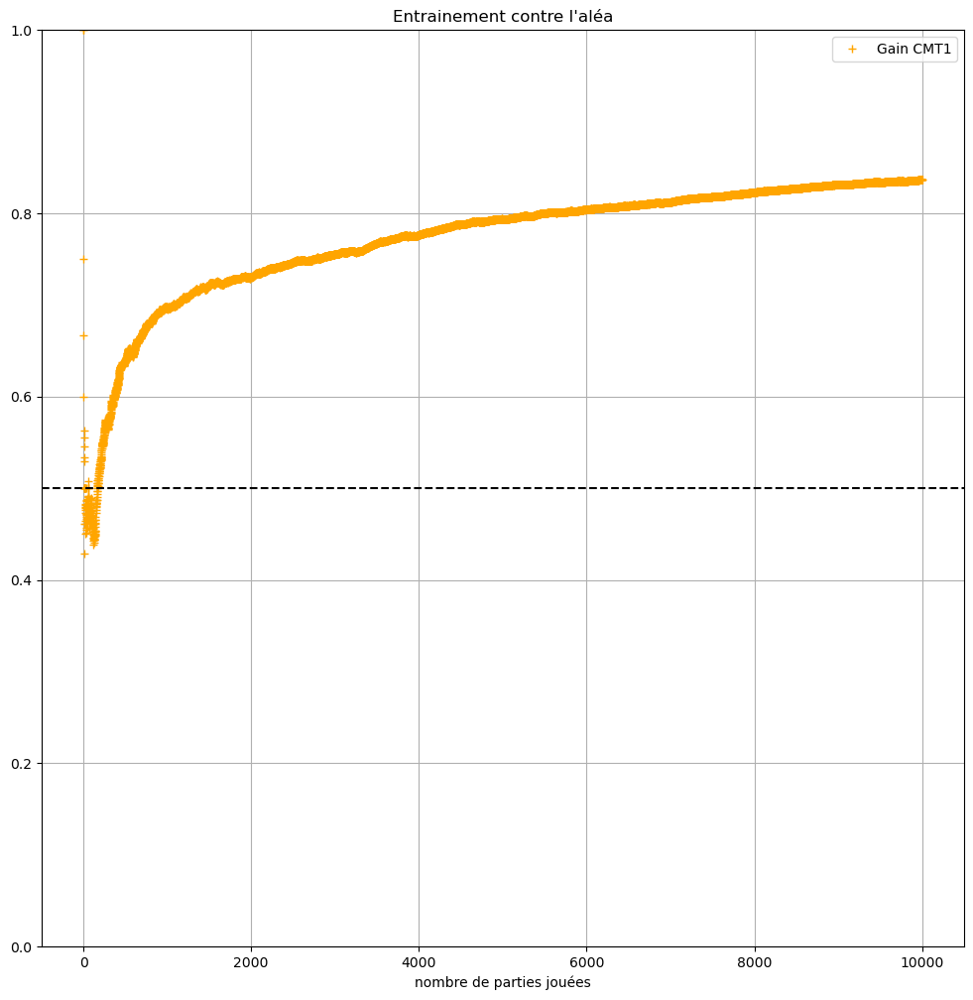

In [48]:
n = 100000

rec1 = [i == 1 for i in rec]
cum = np.cumsum(rec1)
freq = [cum[i]/(i+1) for i in range(len(cum))]
plt.figure(figsize=(12,12))

rg = list(range(1,n+1))

print("Après entrainement contre un environement jouant aléatoirement, l'ordinateur gagne \n --------------", freq[-1], "% du temps")

plt.plot(freq, marker='+',color='orange', linestyle=' ')
plt.legend(["Gain CMT1"])
plt.ylim(0, 1)
plt.axhline(y=0.5, color="black", linestyle="--")
plt.xlabel('nombre de parties jouées')
plt.ylabel('')
plt.title('Entrainement contre l\'aléa')
plt.grid(True)
plt.show()

Après entraînement contre un environnement jouant aléatoirement, l'ordinateur gagne 49.93% du temps.


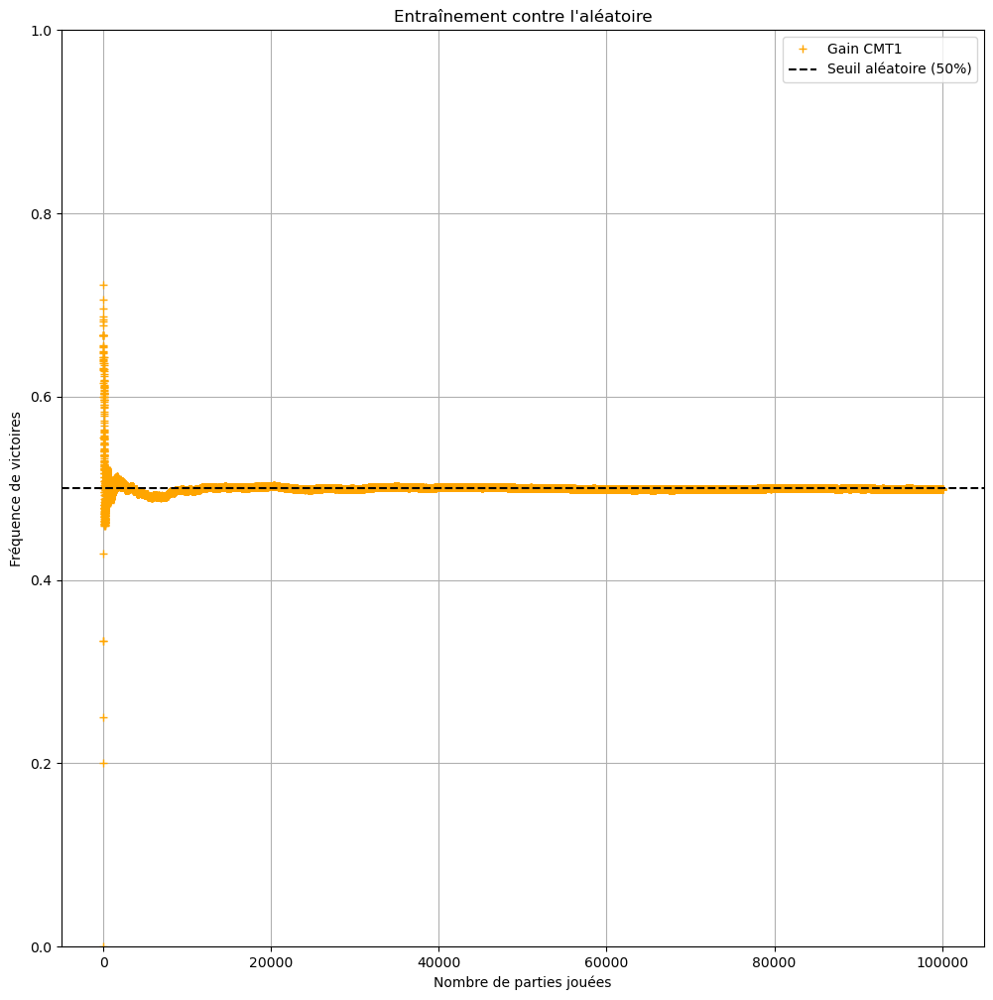

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# Exemple de données de simulation
n = 100000  # Nombre total de parties
rec = np.random.choice([0, 1], size=n, p=[0.5, 0.5])  # Exemple : Adversaire joue aléatoirement

# Calcul des résultats
rec1 = [i == 1 for i in rec]  # Masque booléen des victoires
cum = np.cumsum(rec1)         # Cumul des victoires
freq = [cum[i] / (i + 1) for i in range(len(cum))]  # Fréquence des victoires

# Affichage du pourcentage final
print(f"Après entraînement contre un environnement jouant aléatoirement, l'ordinateur gagne "
      f"{freq[-1] * 100:.2f}% du temps.")

# Création du graphe
plt.figure(figsize=(12, 12))
rg = list(range(1, n + 1))  # Axe x : nombre de parties jouées

plt.plot(freq, marker='+', color='orange', linestyle=' ', label="Gain CMT1")
plt.axhline(y=0.5, color="black", linestyle="--", label="Seuil aléatoire (50%)")
plt.legend()
plt.ylim(0, 1)
plt.xlabel('Nombre de parties jouées')
plt.ylabel('Fréquence de victoires')
plt.title("Entraînement contre l'aléatoire")
plt.grid(True)
plt.show()
